# <b>Time Series Project</b>

## An attempt to build a model that can forecast the daily volume of the bond market in order to predict when that volume will dramatically increase, based purely upon its past history.  
## Secondarily, to see if we can determine if any other financial instruments are leading indicators (i.e. exogenous variables) and account for that to improve predictability

## Project Outline 

1. Obtain and explore the data  
     - explain the data, explore for any inconsistencies, describe any observations  
2. Building a basic ARIMA model and improving that to an 'optimal' SARIMA model
    - discuss stationarity testing, acf & pacf and test for 'best' model parameters minimising some error score  
3. Build a basice facebook Prophet model then improve upon that by adding seasonality  
    - cross-validate for optimal hyperparameters  
    - compare results to the SARIMA model  
4. Determine which financial instruments to explore as leading indicators  
    - import data, explain & create test for time-lagged cross-correlation  
    - discuss whether these exogenous variables add any value to the predictive model  
5. Conclusions: value to the business to be determined plus any scope for improvement  


<div class="alert alert-block alert-info">
    <h2><b>Introduction</b></h2>
<span style="color:black">    
Whilst a lot of work goes into building trading prediction algorithms for forecasting future prices of various financial assets, the impact of a sudden change in trading volumes would be useful to predict. Typically, bank and clearing systems handle millions of transactions a day but in times of crises, systemic risk or 'unexpected' news volumes can increase dramatically as volatility rises.  

This has an impact on the resources needed (both human and technology) to ensure smooth settlement of transaction and keep other potential risks at bay e.g. market, credit and liquidity risk. Such environments also give rise for greater potential for rogue trading or market manipulation since the potential profits and losses are often far greater than normal. 

This project attempts to first build a simple forecasting model for the bond market trading volumes, based upon the volume of the most widely traded instrument, the US 30-year government bond future. I chose to focus on the volume of futures trades since that is freely available and I couldn't readily find data for the daily notional of settled bonds in the cash market.  Futures are traded for settlement 4 times a year on the seventh business day preceding the last business day of March, June, September and December each year.  Typically, the future with the highest volume will be the next one to settle (known as the 'front-month' futures contract).  

***As market participants are able to deal with the expected operational risk of trading activity, and have built-in margins for exceptional activity, I am not interested in predicting the actual volume of daily trading activity with a high margin of accuracy for every day. Rather, it would be more useful to be able to predict when the trading volume would likely be an extreme from the norm for a future day/days.***
</div>

## Import Libraries

In [945]:
# base libraries
import pandas as pd
import numpy as np
from ipywidgets import IntSlider, Output
from IPython.display import display
from time import time
import itertools

# visualisation
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.subplots
import plotly.graph_objects as go

# external data
import quandl

# time series forecasting with facebook prophet
import fbprophet as fbp
from fbprophet.diagnostics import cross_validation, performance_metrics
from fbprophet.plot import plot_cross_validation_metric, plot_plotly

# augmmented Dickey-Fuller test. Test for stationarity
from statsmodels.tsa.stattools import adfuller, kpss

# statsmodels api and ARIMA/SARIMA models
import statsmodels.api as sm
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima_model import ARIMA
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# pmdarima for all arima/sarima modelling providing python implementation of R's auto_arima functionality
import pmdarima as pm
from pmdarima import model_selection
from pmdarima import utils
from pmdarima.arima import ndiffs, nsdiffs
from pmdarima.metrics import smape

# calculating changepoints 
import ruptures as rpt

# jupyter setup
import warnings
warnings.filterwarnings('ignore')

# pandas options
pd.set_option('precision', 4)
pd.set_option('max_columns', None)



<div class="alert alert-block alert-info">
<h2><b>Load some data & initial exploration</b></h2>
<span style="color:black"> 

Firstly explore the front two contracts of the 30-year US Treasury bond future, price and volume.  
We calculate the total volume traded over these two contracts rather than the volume on each one as there are shifts between the front and second contract in terms of daily trading volume (i.e. liquidity) as the front contract comes close to maturity (and the volume traded on it falls to zero).  If we only looked at the front contract there would be regular drops in trading volume every 3 months.  
- it would be even better to include the first 3 or 4 contracts but unfortunately free data is only available on the first two.

In [2]:
mytoken = 'up4jMn8H5KBXavn8shEr'

# Load the data for the front two contracts, keep only 'Open' and 'Volume' features
data_UST_1 = quandl.get("CHRIS/CME_US1", authtoken=mytoken).drop(columns=['High', 'Low', 'Last', 'Change', 'Settle', 'Previous Day Open Interest'])
data_UST_2 = quandl.get("CHRIS/CME_US2", authtoken=mytoken).drop(columns=['High', 'Low', 'Last', 'Change', 'Settle', 'Previous Day Open Interest'])


In [3]:
data_UST_1.head()

,Open,Volume
Date,,
1977-08-22,102.250,341.0
1977-08-23,102.375,145.0
1977-08-24,102.781,207.0
1977-08-25,102.719,158.0
1977-08-26,103.031,168.0


In [4]:
data_UST_2.head()

,Open,Volume
Date,,
1977-08-22,101.781,139.0
1977-08-23,102.031,144.0
1977-08-24,102.375,23.0
1977-08-25,102.312,63.0
1977-08-26,102.594,123.0


In [5]:
data_UST = data_UST_1.merge(data_UST_2, how='inner', left_index=True, right_index=True, suffixes=('_1', '_2'))
data_UST['Total Volume'] = data_UST['Volume_1'] + data_UST['Volume_2']

In [6]:
data_UST.head()

,Open_1,Volume_1,Open_2,Volume_2,Total Volume
Date,,,,,
1977-08-22,102.250,341.0,101.781,139.0,480.0
1977-08-23,102.375,145.0,102.031,144.0,289.0
1977-08-24,102.781,207.0,102.375,23.0,230.0
1977-08-25,102.719,158.0,102.312,63.0,221.0
1977-08-26,103.031,168.0,102.594,123.0,291.0


In [7]:
data_UST.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 10730 entries, 1977-08-22 to 2020-04-16
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Open_1        10710 non-null  float64
 1   Volume_1      10730 non-null  float64
 2   Open_2        10673 non-null  float64
 3   Volume_2      10730 non-null  float64
 4   Total Volume  10730 non-null  float64
dtypes: float64(5)
memory usage: 503.0 KB


In [8]:
# Add an approximate 3 month moving average

data_UST['3m Moving Average'] = data_UST['Total Volume'].rolling(window=63).mean().values

# convert Volume to integer
data_UST['Total Volume'] = data_UST['Total Volume'].astype('int')


In [9]:
data_UST.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 10730 entries, 1977-08-22 to 2020-04-16
Data columns (total 6 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Open_1             10710 non-null  float64
 1   Volume_1           10730 non-null  float64
 2   Open_2             10673 non-null  float64
 3   Volume_2           10730 non-null  float64
 4   Total Volume       10730 non-null  int32  
 5   3m Moving Average  10668 non-null  float64
dtypes: float64(5), int32(1)
memory usage: 544.9 KB


<div class="alert alert-block alert-info">
    
<h2><b>Common functionality</b></h2>
<span style="color:black">    
Section to store common functions created and used throughout the project, e.g. plotting graphs, statistical tests

In [457]:
# base figure for plotly graphs

def plotly_base_fig(title, xtitle, ytitle, **params):
    """
    The base figure for all plotly graphs in this project
    
    Parameters:
    -----------
    title: the chart title
    xtitle: the x-axis title
    ytitle: the y-axis title
    **params: any parameters to pass to the plotly.subplots.make_subplots() function
    
    Returns:
    -----------
    The plotly figure
    """
    
    fig = plotly.subplots.make_subplots(**params)
    fig.update_layout(height=800, width=1500, 
                      title=title, 
                      xaxis_title=xtitle, 
                      yaxis_title=ytitle, 
                      legend=dict(x=0, y=1))

    fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(count=5, label="5y", step="year", stepmode="backward"),
            dict(step="all")
            ])
        )
    )
    
    return fig

In [12]:
# Seasonal Decomposition Graphs

def seasonal_decom_plot(data, model='additive', period=63):
    """
    The returns the figure for an interactive plotly graph of the seasonal decomposition of the time series
    
    Parameters:
    -----------
    data:    a series with DateTimeIndex and values
    period:  the periodicity of seasonality to be plotted. Default = 63, i.e. 63 working days in a quarter year
    
    Returns:
    -----------
    The plotly figure
    """

    decomposition = seasonal_decompose(data, model=model, period=period)

    trend = decomposition.trend
    seasonal = decomposition.seasonal 
    residual = decomposition.resid
    
    fig = plotly_base_fig(title='Seasonal Decomposition: Total Daily Volume of US Treasury Futures', 
                          xtitle='Date', 
                          ytitle='Total Volume')

    fig.add_scatter(x=trend.index, y=trend.values, mode='lines', name='Trend')
    fig.add_scatter(x=seasonal.index, y=seasonal.values, mode='lines', name='Seasonality')
    fig.add_scatter(x=residual.index, y=residual.values, mode='lines', name='Residuals', opacity=0.5)

    return fig

In [951]:
# remove weekends from your dates

def remove_weekends(df, datecol='ds'):
    """
    Function to remove all weekdays from the rows where the datecol holds the dates
    
    Parameters:
    -----------
    df: a pandas dataframe
    datecol: the column holding the dates to filter on
    
    Returns:
    -----------
    The filtered dataframe
    """
    result = df[df[datecol].dt.dayofweek < 5]
    return result

In [14]:
# mean absolute percentage error

def mean_absolute_percentage_error(y_true, y_pred):
    """
    Function to calculate the mean absolute percentage error between two, equally-sized series
    
    Parameters:
    -----------
    y_true, y_pred: separate series or lists of equal size. Typically y_true is the actual values and y_pred the predicted values.
    
    Returns:
    -----------
    The MAPE calculation * 100
    """
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [594]:
def realised_vol(data, window=21, dpy=252, log_returns=True):
    """
    This function calculates the annualised, realised (daily) volatility for the series (data).
    For financial assets it is typical to base the calculation on the log of the returns and assume a mean of zero. Otherwise, pct_change is used.
    If the data ever goes below zero, then set log_returns=False
    
    Parameters:
    -----------
    data: a series, array or list of values
    window: the number of (daily) periods over which to calculate the realised volatility
    dpy: the number of (daily) periods in a year
    
    Returns:
    -----------
    3 series: log_returns, realised_variance, realised_volatility
    
    """

    window = 21  # trading days in rolling window
    dpy = 252  # trading days per year
    ann_factor = dpy / window
    
    if log_returns:

        log_rtn = np.log(data).diff()

        # Var Swap (returns are not demeaned)
        real_var = np.square(log_rtn).rolling(window).sum() * ann_factor
        real_vol = np.sqrt(real_var)

        return log_rtn, real_var, real_vol
    
    else:
        
        pct_rtn = data.pct_change()
        
        real_var = pct_rtn.rolling(window).var() * ann_factor
        real_vol = np.sqrt(real_var)
        
        return pct_rtn, real_var, real_vol
        


In [852]:
def prophet_cvstats(cvmodels):
    """
    This function takes in a dictionary of facebook profit cross-validation models and returns a formatted dataframe of goodness of fit stats for the max tenor of the cross-validation prediction
    Assumes already imported 'from fbprophet.diagnostics import cross_validation, performance_metrics'
    
    Parameters:
    --------------
    cvmodels: a dictionary of fbProphet cross-validation models
    
    Returns:
    --------------
    A formatted dataframe highlighting the minimum values for each statistic

    """
    
    allstats = pd.concat([performance_metrics(v, rolling_window=1) for v in cvmodels.values()])
    allstats.index = cvmodels.keys()
    allstats = allstats.style.highlight_min(color='lightgreen', subset=['mse', 'rmse', 'mae', 'mape', 'mdape'], axis=0)
    
    return allstats

<div class="alert alert-block alert-info">
<h2><b>Changepoints</b></h2>
<span style="color:black">    
    
Changepoint detection looks to determine algorithmically when there are abrupt changes to the trend of a time series. This helps us to determine better whether:  
 - there are distinct states in a time series
 - any anomalous sequences
 - sudden changes in a time series' state

I am using the PELT (Pruned Exact Linear Time) algorithm and the 'ruptures' package to determine changepoints in the history of the data. The PELT search method is an exact method.  

<u>References</u>  
https://towardsdatascience.com/a-brief-introduction-to-change-point-detection-using-python-d9bcb5299aa7  
http://ctruong.perso.math.cnrs.fr/ruptures-docs/build/html/detection/pelt.html  

We can then use this information to interpret better what the time series is showing us and determine how to approach any different states/sequences. For example we may then want to answer these questions about separate states:  
- do we remove them?
- do we build separate models for them?

In [449]:
brkpts = rpt.Pelt(model='rbf')
brkpts.fit(data_UST['Total Volume'].values)
mybrkpts = brkpts.predict(pen=10)

## Visualise the whole time series

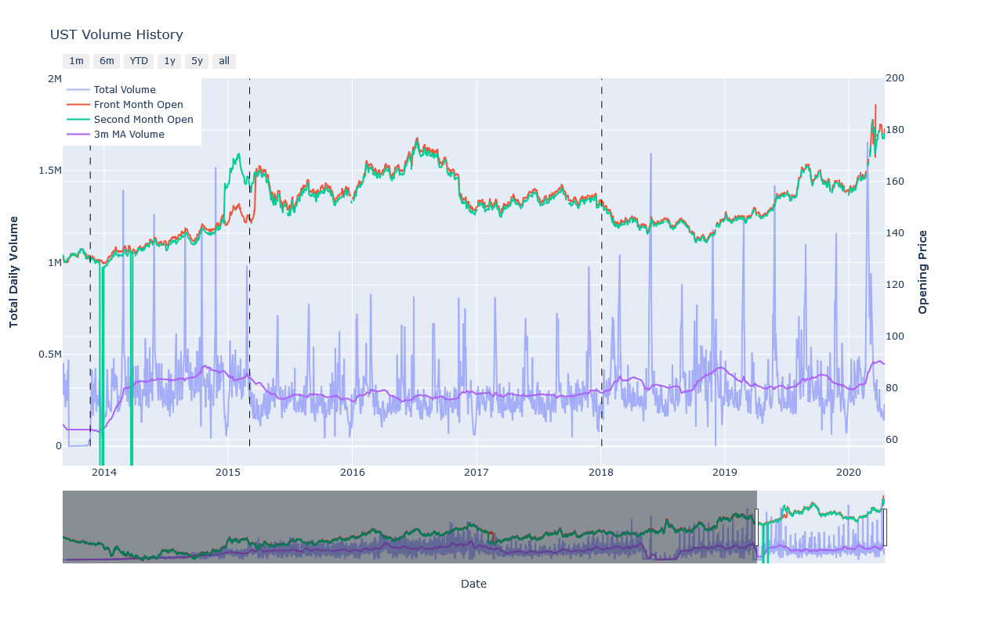

In [698]:
# base figure
fig = plotly_base_fig('UST Volume History', 'Date', 'Volume', specs=[[{"secondary_y": True}]])

# add time series lines
fig.add_scatter(x=data_UST.index, y=data_UST['Total Volume'], mode='lines', name='Total Volume', opacity=0.5)
fig.add_scatter(x=data_UST.index, y=data_UST['Open_1'], mode='lines', secondary_y=True, name='Front Month Open')
fig.add_scatter(x=data_UST.index, y=data_UST['Open_2'], mode='lines', secondary_y=True, name='Second Month Open')
fig.add_scatter(x=data_UST.index, y=data_UST['3m Moving Average'], mode='lines', name='3m MA Volume')

# Set y-axes titles
fig.update_yaxes(title_text="<b>Total Daily Volume</b>", secondary_y=False)
fig.update_yaxes(title_text="<b>Opening Price</b>", range=[50, 200], secondary_y=True)

# Add vertical lines
for ln in mybrkpts[:-1]:
    fig.add_shape(dict(type='line', 
                       x0=data_UST.index[ln], 
                       y0=0, 
                       x1=data_UST.index[ln], 
                       y1=2e6, 
                       line=dict(color='black', width=1, dash='dash')
                      )
                 )

fig.show()

<div class="alert alert-block alert-warning">

<h2><b>Summary of Visual Interpretations</b></h2>
<span style="color:black">    

*Trend and Seasonalities*  
1) At first glance, the trend appears to be growing up to 1987 (probably because the market was getting more liquid as technology improved, the Big Bang occured and futures trading became more liquid) and then oscillates around 200-400k contracts/day with varying degrees of range/volatility  
2) When we look at the moving average that tells us there are a number of sub-trends:
    - there appears to be a longer-term seasonality of 7-10 years within the overall trend
    - within each of these there are some potentially regular sub-seasonalities

*Changepoints*
1) The Changepoints do seem to have initially a good coincidence with the longer-term seasonality  
2) It matches with the breaks in the data sets (see below)  
3) Later changepoints identified from Jun-2009 onwards (especially Mar-2015 & Jan-2018) are followed by quite different periods of volatility (or range of daily volume) than previously.  

The Changepoints have identified both economic cycles (the longer-term seasonality) and when there is a fundamental increase/decrease in trading volume that does go on for some time. This is useful as it may be better to build separate models for each of these periods, testing for any future changepoint, or a larger model that incorporates each of these periodic states separately. *This is beyond the scope of this project*

*Low/Zero volume:*
1) Oct-2007 - Jul-2009  
2) (21-Jun-2013 - 21-Aug-2013) & (19-Sep-2013 - 19-Nov-2013)  

The most likely explanation for this is due to missing data in the history. In order to get a reasonable trend from this we are left with a few options:  
1) remove all data points with a Total Volume < [50,000]  
2) build a model with the data up to each of the first period (Oct-2007) and use that to predict for the first missing period. Then repeat for the second period. Once all missing data is filled in, build a new model on all the data (or that subset we are going to focus upon)  
3) start our analysis after 19-Nov-2013

Changepoints have clearly picked up a lot of this information. It may also be the case that if the missing/low data was corrected for, then the changepoints would identify even more clearly with the typical 7-10 year economic cycle in this period and there would be less changepoints overall.  

<b>I am going to start with option (3) since we can use 6 years data to build a predictive model from here</b>.  

It may be possible to find the missing data or correct for it some other way to build a model that incorporates all of this information and its many changepoints, but that is going to be beyond the scope of this project


<div class="alert alert-block alert-info">
<h2><b>Decomposing the Time Series</b></h2>
<span style="color:black">    
    
A Time Series can be decomposed into constituent parts consisting of:  

1) Level: the average value in the series  
2) Trend: the increasing or decreasing value in the series  
3) Seasonlity: the repeating short-term cycle in the series  
4) Noise: the random variation in the series  

Furthermore, these may be brought together in either an Additive or Multiplicative model as defined as:  

1) Additive:  $y(t) = Level + Trend + Seasonlity + Noise$  
2) Multiplicative:  $y(t) = Level * Trend * Seasonlity * Noise$

<b>I would suggest that this data seems to be more likely to be from an Additive model but it is difficult to be certain as the trend is effectively zero</b> 

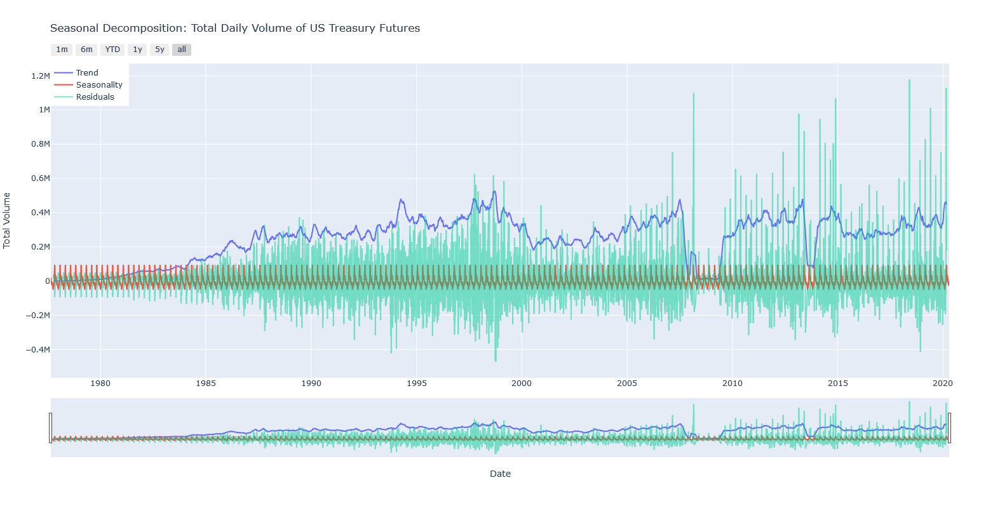

In [15]:
Volume = data_UST['Total Volume']
#Volume.index = pd.DatetimeIndex(Volume.index)

fig = seasonal_decom_plot(Volume)
fig.show()

<div class="alert alert-block alert-warning">
<h2><b>Visual Interpretations of Decompositions</b></h2>

<span style="color:black">
This data is in line with the earlier visual analysis.  

*The trend component*   

This is similar to the 3 month moving average and still shows at least <b>2 distinct periods</b>:  

1) From the start until a peak in September 1987. A geometric growth rate up to ~300k  
2) From September 1987 until July 1993 it oscillated around 270k per day  
3) From July 1993 though it appears to have become more complex, with at least <b>2 seasonal sub-trends</b>:  
- a longer-term oscillation that lasts 7-10 years  
- a shorter-term one that lasts ~6 months  
    
Additionally, it should be noted that we need to determine that there is truly incorrect/missing data for the two sharp drops mentioned previously.  

*The seasonality & residuals components*  

As deconstructed here, the seasonality component is relatively low with a range of [-50k, +90k] when compared to the residuals component which becomes more volatile up to 1987, then again from Nov-1997 to Jan-2000 and then again with far more frequent spikes upwards from Mar-2007 to the present day.  

These periods do coincide with some significant market events:  
- 1987: the movement from 'open-outcry' to electronic trading and the stock market crash in Oct-87
- 1997/8: Russia crisis, emerging market currency/dect crises and failure of Long-Term Capital Management
- 2001: the first dot-com boom/bust
- 2008: Lehman Bros collapse and the credit crisis (can also consider Bear Stearns earlier in 2008 and Northen Rock in Aug-2007)  

<b>Potentially, we can also investigate whether there are any leading signals from other financial markets - probably based on % change in price/volatility </b>
    </span>
    </div>

<div class="alert alert-block alert-info">
<h1><b>Model 1: basic model</b></h1>    
<h2><b>Dec-2013 onwards, Proof of Concept</b></h2>
<span style="color:black">    
    
There are a lot of data points to work with, let's first build a simple model to see if we can fit some smaller part of this data  

Why this period?  
- It starts after the last, unexplained dip in volume finishes
- It also has a potentially interesting change in the volatility of the trend between Apr-2015 to Nov-2017 where that seems to be much less than prior or after this period and may create some challenges to the modelling  
- By starting with the last trading date of the December-2013 contract, we are building the model by using a known/expected cyclical starting point which should make it easier to interpret

In [704]:
# Define the data to work with - 7 business days prior to the last business day of Dec-2013
model1data = Volume[Volume.index >= '2013-12-17'] 


In [705]:
# Check for any outlier values. There may be some very low values we haven't picked up on:

model1data.sort_values(ascending=True)

Date
2018-12-05        244
2014-11-11      41000
2015-10-12      42224
2015-12-24      46624
2017-10-09      48183
               ...   
2019-05-28    1419554
2020-02-26    1481644
2014-11-25    1519353
2018-05-29    1596524
2020-02-25    1656106
Name: Total Volume, Length: 1593, dtype: int32

### There is 1 value here that is significantly out of touch with all other values.  The options we have are:  

1) delete it  
3) make it the same as the previous/next value  
2) interpolate for it - this could be a simple average of the values before/after it or building a time series model with prior data and forecasting that one point.  

***For simplicity and because it is only 1 data point, I will take the option to make it a simple average of the values immediately preceding/after it***

In [706]:
model1data['2018-12-03':'2018-12-07']

Date
2018-12-03    383898
2018-12-04    611514
2018-12-05       244
2018-12-06    694096
2018-12-07    483211
Name: Total Volume, dtype: int32

In [707]:

# set it to NaN
model1data['2018-12-05'] = np.nan

# interpolate
model1data = model1data.interpolate()
model1data['2018-12-03':'2018-12-07']

Date
2018-12-03    383898.0
2018-12-04    611514.0
2018-12-05    652805.0
2018-12-06    694096.0
2018-12-07    483211.0
Name: Total Volume, dtype: float64

<b>Autocorrelation:</b> 

The correlation of a time series with previous time steps (i.e. lags). A plot of the autocorrelation of a time series by lag is called the AutoCorrelation Function (ACF). This plot is sometimes called a correlogram or an autocorrelation plot.

<b>Partial Aurocorrelation Function:<b>  
    
The PAF attempts to remove any indirect correlations between the observation at a point in time and any intervening observations between it and the one being correlated against. Thus, it describes the direct relationship between an observation and its lag

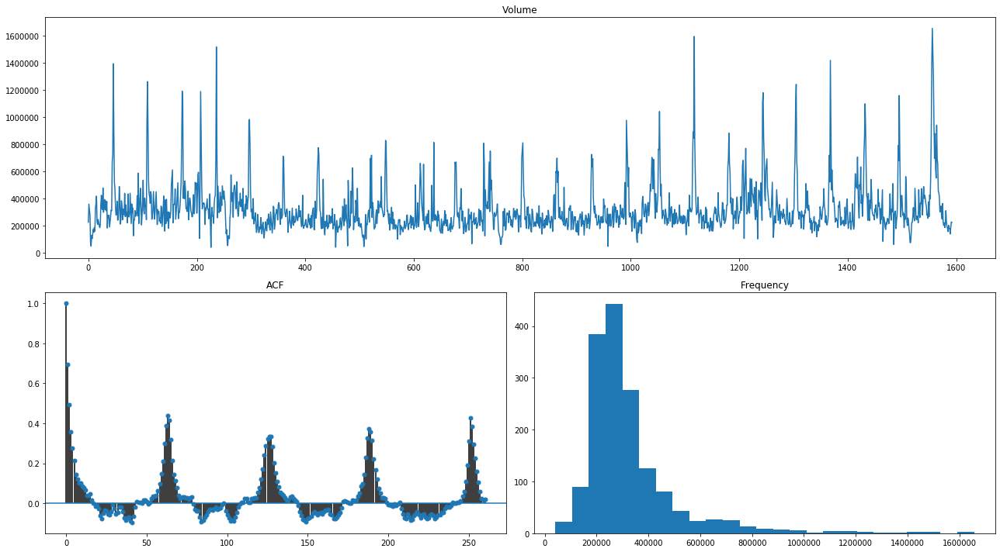

In [708]:
# use the built-in pmdarima plotting functionality to look at some basic graphs

# lag = 260 implies at least 1 year of data
pm.tsdisplay(model1data, lag_max=260, title="Volume", figsize=(18, 10), show=True) 

In [709]:
acf = utils.acf(model1data, nlags = 190, alpha=0.05)
pacf = utils.pacf(model1data, nlags = 190, alpha=0.05)


There is definitely some repeating seasonality here. For better clarity I will plot the acf & pacf graphs along with their confidence intervals.  Any points outside of the confidence interval (set at 95%) are more likely to be significant to the determination of the forecast.

In [191]:
# fig, ax = plt.subplots(2,1,figsize=(20,16))
# ax[0] = utils.plot_acf(model1data, lags=190, alpha=0.05, show=False, ax=ax[0])
# ax[1] = utils.plot_pacf(model1data, lags=190, alpha=0.05, show=False, ax=ax[1])
# fig.show();

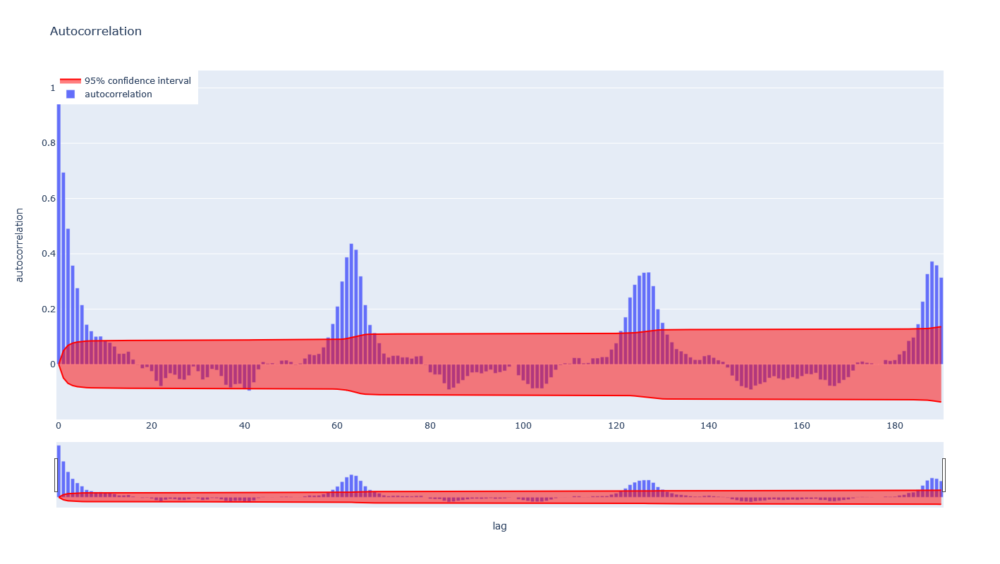

In [711]:
#fig = px.bar(x=range(0,191), y=acf[0], labels={'x': 'lag', 'y':'autocorrelation'}, title='Autocorrelation')

fig = plotly_base_fig('Autocorrelation', 'lag', 'autocorrelation')
fig.add_trace(go.Bar(x=list(range(0,191)), y=acf[0][:191], name='autocorrelation', opacity=1.0))
fig.add_scatter(x=list(range(0,191)), y=(acf[1][:191,0]-acf[0][:191]), mode='lines', name='low_conf', line_color='red', opacity=0.5, showlegend=False)
fig.add_scatter(x=list(range(0,191)), y=(acf[1][:191,1]-acf[0][:191]), mode='lines', name='95% confidence interval', line_color='red', opacity=0.5, fill='tonexty')

fig.show()

<div class="alert alert-block alert-warning">
<h3><b>Interpreting the Autocorrelation graph</b></h3>    
<span style="color:black">   
      
The graph implies that there is significant autocorrelation that repeats continuously every 63 days (i.e. 3 months). This would tie up with the expiry of the front month future and roll into the next future every quarter.  
It is interesting to note that the confidence intervals hardly differ: this may imply there are many (hidden) facets to the data series that a simple model may not account for accurately. Or that the data is too complex to model with any acceptable level of accuracy (howsoever that is defined).

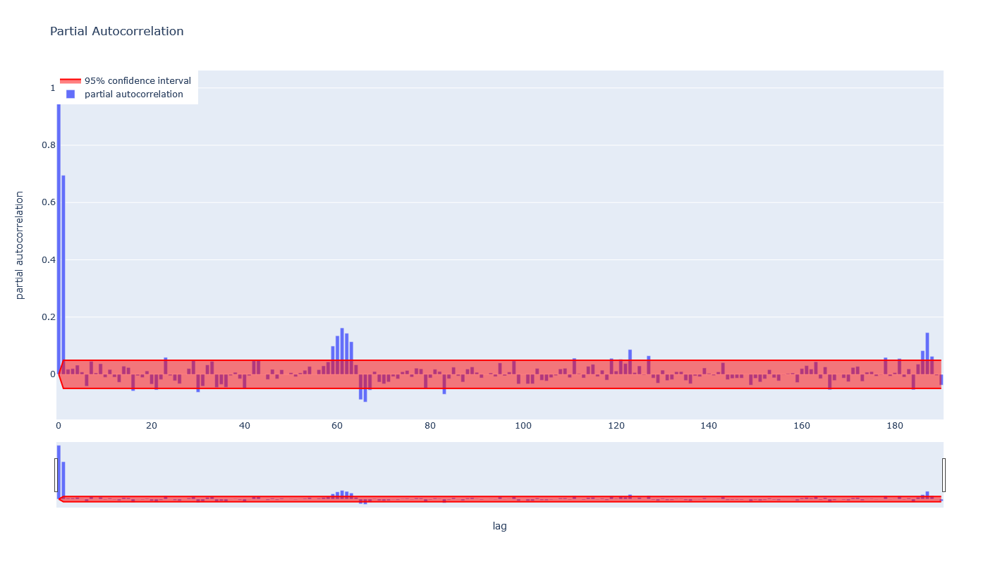

In [710]:
# px.bar(x=range(0,191), y=pacf[0], labels={'x': 'lag', 'y':'partial autocorrelation'}, title='Partial Autocorrelation')

fig = plotly_base_fig('Partial Autocorrelation', 'lag', 'partial autocorrelation')
fig.add_trace(go.Bar(x=list(range(0,191)), y=pacf[0][:191], name='partial autocorrelation', opacity=1.0))
fig.add_scatter(x=list(range(0,191)), y=(pacf[1][:191,0]-pacf[0][:191]), mode='lines', name=None, line_color='red', opacity=0.5, showlegend=False)
fig.add_scatter(x=list(range(0,191)), y=(pacf[1][:191,1]-pacf[0][:191]), mode='lines', name='95% confidence interval', line_color='red', opacity=0.5, fill='tonexty')

fig.show()

<div class="alert alert-block alert-warning">
<h3><b>Interpreting the Partial Autocorrelation graph</b></h3>    

<span style="color:black">   

Partial autocorrelation shows us that actually the main relevant historical point to determine today's value is the  previous days' value. However, there is also a spike in partial autocorrelation at the 61-day marker, again a further indication of seasonality beyond just the basic ARIMA model.
    </span>
    
<h3><b> Summary of the acf & pacf graphs</b></h3>
<span style='color:black'>
    
1) Autocorrelations is quite persistent: at least 5 lags initially  
2) There is a rise in autocorrelation approx. every 63 days implying a seasonal factor here.  
3) There is also a smaller, negative seasonality from the acf graph that lasts between 20 & 40 days after the beginning of each 63 day cycle. This may be a single, longer-lasting period or perhaps two separate ones peaking at those times, but it is outside of the significance threshold.  
4) Partial autocorrelation drops after after just 1 lagged period but again rises after 61 days, reinforcing the seasonality expectation

<div class="alert alert-block alert-info">

<h2><b>Stationarity Testing</b></h2>
<span style="color:black">   


The daily volume appears to stabilise at between 200 - 400k contracts a day with some regular, potentially cyclical peaks.  Ensuring that the time series is statistically stable around a mean (i.e. has constant variance around a constant mean) is important. For time series models to work this must be the case as then the statistical properties of a time series generating process do not change over time, i.e. the way it changes does not change, not that the series itself does not change.  

You can think of this as being analogous to a linear function with a constant slope. Once stationarity is determined, then the way the time series is modelled doesn't change and it becomes easier to create a predictive model.

Data needs to satisfy these requirements to ensure stationarity:
- constant mean
- constant variance
- constant autocorrelation
- no periodic component  

Stationarity testing is a statistical measurement of the probability that each observation is independent from any previous observations. The two main tests of stationarity are the (Augmented) Dickey-Fuller test and the KPSS test which are looked at more closely below.

<div class="alert alert-block alert-info">

    
<h3>1a) Dickey-Fuller test</h3>
    <span style="color:black">   
<p> The Dickey-Fuller test is testing if $\phi=0$ in this model of the data:<br>
    <center> $y_t = \alpha + \beta t + \phi y_{t-1} + e_t$ </center> <br>
    which is written as  <br>
    <center> $\Delta y_t = y_t-y_{t-1} = \alpha + \beta t + \gamma y_{t-1} + e_t$ </center>  <br>
    where $y_t$ is your data. <br>
    It is written this way so we can do a linear regression of $\Delta y_t$ against $t$ and $y_{t-1}$ and test if $\gamma$ is different from $0$. If $\gamma=0$, then we have a random walk process. If not and $-1<1+\gamma<1$, then we have a stationary process.</p>
    </span>
    
<h3>1b) Augmented Dickey-Fuller test </h3>
    <span style="color:black">
<p> The Augmented Dickey-Fuller test allows for higher-order autoregressive processes by including $\Delta y_{t-p}$ in the model, but our test is still if $\gamma = 0$. <br>
    <center> $\Delta y_t = \alpha +\beta t + \gamma y_{t-1} + \lambda_1 \Delta y_{t-1} + \lambda_2 \Delta y_{t-2} + {...}$ </center>
    The null hypothesis for both tests is that the data are non-stationary. We want to REJECT the null hypothesis for this test, so we want a p-value of less that 0.05 (or smaller).
    


<div class="alert alert-block alert-info">

<h3>2) KPSS test</h3>
    <span style="color:black">   
<p>In contrast to the Augmented Dickey-Fuller test, the KPSS test null hypthesis is that the data <b>is</b> stationary. For this test, we do NOT want to reject the null hypothesis. In other words, we want the p-value to be greater than 0.05 not less than 0.05.  
    
It figures out if a time series is stationary around a mean or linear trend, or is non-stationary due to a unit root.  It is also based on linear regression breaking the series up into 3 parts such that:<br>
    <center>$y_t = \gamma_t + \beta t + \epsilon_1$</center><br>
    where,<br>
    $\gamma_t$ = a random walk<br>
    $\beta t$ = a deterministic trend<br>
    $\epsilon_1$ = a stationary error<br>
    If the data is stationary, it will have a fixed element for an intercept or the series will be stationary around a fixed level: there is a slightly different test for level or trend stationarity.
</p>

In [712]:
# Is the current series stationary?

# augmented dickey-fuller test
adftest = pm.arima.ADFTest(alpha=0.05)
print('ADF test results: {}'.format(adftest.should_diff(model1data)))

# kpss test
kpsstest = pm.arima.KPSSTest(alpha=0.05)
print('KPSS test results: {}'.format(kpsstest.should_diff(model1data)))

ADF test results: (0.01, False)
KPSS test results: (0.021045956446409064, True)


### Calculate the value of d: the number of times to difference the data for stationarity of a basic ARIMA model

The usual procedure to remove any non-stationarity is to first transform the time series into a linear trend then repeatedly difference it until it is stationary (as determined by the ADF/KPSS tests). The pmdarima package can automatically calculate the number of differences neceassary to achieve stationarity which I will take to be the maximum of the number of differences determined necessary by each of those tests separately.

In [713]:
# Estimate the number of differences to do, i.e. the value of 'd'

kpss_diffs = ndiffs(model1data, alpha=0.05, test='kpss', max_d=63)
adf_diffs = ndiffs(model1data, alpha=0.05, test='adf', max_d=63)
n_diffs = max(adf_diffs, kpss_diffs)

print(f"Estimated differencing term: {n_diffs}")


Estimated differencing term: 1


In [714]:
kpss_diffs, adf_diffs

(1, 0)

### If you double-check these values with statsmodels you can see more explicit information too. It confirms the number of differences to take is just 1

In [715]:
adf, pvalue, usedlag_, nobs_, critical_values_, icbest_ = adfuller(model1data)

print('Test statistic:\t{}'.format(adf))
print('p-value:\t{}'.format(pvalue))
print('Used lag:\t{}'.format(usedlag_))
print('#observations:\t{}'.format(nobs_))
print('Critical values: {}'.format(critical_values_))


Test statistic:	-16.92844140563622
p-value:	9.81862888575916e-30
Used lag:	0
#observations:	1592
Critical values: {'1%': -3.4344642432857992, '5%': -2.8633571955690647, '10%': -2.5677374399794197}


In [716]:
kpsstest, pvalue, usedlag_, critical_values_ = kpss(model1data, nlags=1)

print('Test statistic:\t{}'.format(kpsstest))
print('p-value:\t{}'.format(pvalue))
print('Used lag:\t{}'.format(usedlag_))
print('Critical values: {}'.format(critical_values_))

Test statistic:	1.4354910318554042
p-value:	0.01
Used lag:	1
Critical values: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}


### Calculate the value of D: the number of times to difference the data for stationarity of the seasonal component of a SARIMA model

Use m=61: this is the peak of the pacf graph and is almost quarterly, business days seasonality (that would be m=63)

In [717]:
D = nsdiffs(model1data, m=61, max_D=5, test='ch')

print(f"Estimate seasonal D is: {D}")

Estimate seasonal D is: 0


<div class="alert alert-block alert-success">
<h2><b>Optimal values for d & D</b></h2>
<span style="color:black"> 

<b>The pmdarima package estimates that for stationarity, d=1 and D=0</b>

<div class="alert alert-block alert-info">
<h2><b>Model 1: ARIMA</b></h2>    
<span style="color:black">   

An ARIMA model is an AutoRegressive Integrated Moving Average model for forecasting time series can be broken down into these components:  

AR(p): Autoregressive - models the next step in the sequence as a linear function of the observations at prior time steps  
I(d): Integrated - a differencing pre-processing step to make the sequence stationary, called Integration. Suitable for modelling trend  
MA(q): Moving Average - models the next step in the sequence as a linear function of the residual errors from a mean process at prior time steps  

AR(p) can be written as: $X(t) = A(1) * X_{t-1} + A(2) * X_{t-2} + ... +  A(2) * X_{t-p} + E(t)$  

MA(q) can be written as: $X(t) = -B(1) * E_{t-1} -B(2) * E_{t-2} - ... -B(q) * E_{t-q} + E(t)$
  
The ARIMA model can be written as:  
<center>$\Large\text{ARIMA}(p,d,q)$</center>

In [726]:
# automatically calculate the optimal hyperparameters for the basic ARIMA model

auto = pm.auto_arima(model1data, seasonal=False, stepwise=True,
                     d=1, max_d=1,
                     start_p=1, max_p=10,
                     start_q=1, max_q=3, 
                     suppress_warnings=True, error_action="ignore", max_order=None, trace=True, 
                     with_intercept=True)

Performing stepwise search to minimize aic
Fit ARIMA: (1, 1, 1)x(0, 0, 0, 0) (constant=True); AIC=42021.637, BIC=42043.128, Time=2.252 seconds
Fit ARIMA: (0, 1, 0)x(0, 0, 0, 0) (constant=True); AIC=42271.054, BIC=42281.799, Time=0.082 seconds
Fit ARIMA: (1, 1, 0)x(0, 0, 0, 0) (constant=True); AIC=42228.436, BIC=42244.554, Time=0.203 seconds
Fit ARIMA: (0, 1, 1)x(0, 0, 0, 0) (constant=True); AIC=42207.384, BIC=42223.502, Time=0.238 seconds
Fit ARIMA: (0, 1, 0)x(0, 0, 0, 0) (constant=False); AIC=42269.054, BIC=42274.427, Time=0.057 seconds
Fit ARIMA: (2, 1, 1)x(0, 0, 0, 0) (constant=True); AIC=42030.024, BIC=42056.887, Time=1.075 seconds
Fit ARIMA: (1, 1, 2)x(0, 0, 0, 0) (constant=True); AIC=42022.114, BIC=42048.978, Time=2.015 seconds
Near non-invertible roots for order (1, 1, 2)(0, 0, 0, 0); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.995)
Fit ARIMA: (0, 1, 2)x(0, 0, 0, 0) (constant=True); AIC=42145.365, BIC=42166.856, Time=0.306 second

In [727]:
auto.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                 1593
Model:               SARIMAX(2, 1, 2)   Log Likelihood              -21004.105
Date:                Mon, 27 Apr 2020   AIC                          42020.209
Time:                        16:58:27   BIC                          42052.446
Sample:                             0   HQIC                         42032.183
                               - 1593                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     59.4671     66.518      0.894      0.371     -70.905     189.839
ar.L1         -0.2647      0.050     -5.264      0.000      -0.363      -0.166
ar.L2          0.6409      0.038     16.817      0.000       0.566       0.716
ma.L1         -0.0333      0.044     -0.751      0.452      -0.120       0.054
ma.L2         -0.9537      0.044    -21.567      0.000      -1.040      -0.867
sigma2      1.814e+10   6.76e-06   2.68e+15      0.000    1.81e+10    1.81e+10
===================================================================================
Ljung-Box (Q):                       65.18   Jarque-Bera (JB):              8882.49
Prob(Q):                              0.01   Prob(JB):                         0.00
Heteroskedasticity (H):               1.05   Skew:                             2.11
Prob(H) (two-sided):                  0.57   Kurtosis:                        13.77
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 1.04e+30. Standard errors may be unstable.
"""

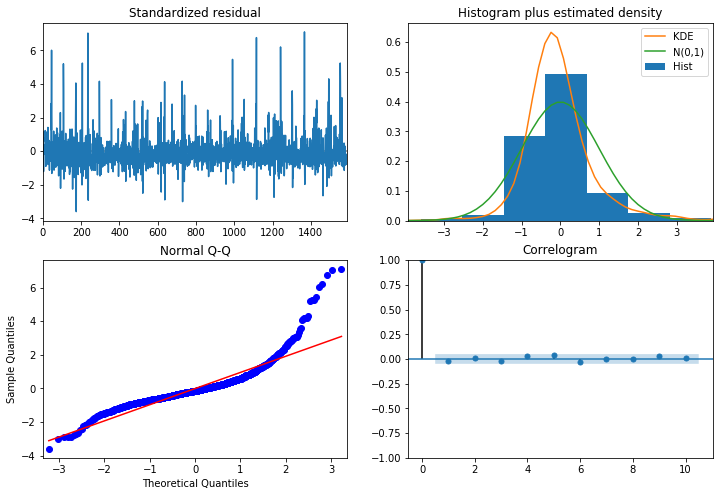

In [728]:
auto.plot_diagnostics(figsize=(12,8));

***Model1: Summary***  

- This model implies that the daily volume is almost all noise as the coefficient of the random element is so much greater than all others
- the p-values for both the intercept and the 1st pacf lag are significantly >0.05. **We can remove the intercept but I don't think we can remove an earlier moving average (q) parameter**

In [729]:
# Rebuild the basic arima model without an intercept:
auto = pm.auto_arima(model1data, seasonal=False, stepwise=True,
                     d=1, max_d=1,
                     start_p=1, max_p=10,
                     start_q=1, max_q=3, 
                     suppress_warnings=True, error_action="ignore", max_order=None, trace=True, 
                     with_intercept=False)

auto.summary()


Performing stepwise search to minimize aic
Fit ARIMA: (1, 1, 1)x(0, 0, 0, 0) (constant=False); AIC=42019.815, BIC=42035.933, Time=0.697 seconds
Fit ARIMA: (0, 1, 0)x(0, 0, 0, 0) (constant=False); AIC=42269.054, BIC=42274.427, Time=0.052 seconds
Fit ARIMA: (1, 1, 0)x(0, 0, 0, 0) (constant=False); AIC=42226.435, BIC=42237.181, Time=0.139 seconds
Fit ARIMA: (0, 1, 1)x(0, 0, 0, 0) (constant=False); AIC=42205.383, BIC=42216.129, Time=0.170 seconds
Fit ARIMA: (2, 1, 1)x(0, 0, 0, 0) (constant=False); AIC=42021.635, BIC=42043.126, Time=0.891 seconds
Near non-invertible roots for order (2, 1, 1)(0, 0, 0, 0); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.995)
Fit ARIMA: (1, 1, 2)x(0, 0, 0, 0) (constant=False); AIC=42020.295, BIC=42041.786, Time=1.459 seconds
Near non-invertible roots for order (1, 1, 2)(0, 0, 0, 0); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.995)
Fit ARIMA: (0, 1, 2)x(0, 0, 0, 0) (

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                 1593
Model:               SARIMAX(2, 1, 2)   Log Likelihood              -21003.761
Date:                Mon, 27 Apr 2020   AIC                          42017.521
Time:                        17:01:30   BIC                          42044.385
Sample:                             0   HQIC                         42027.499
                               - 1593                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2624      0.051     -5.161      0.000      -0.362      -0.163
ar.L2          0.6424      0.038     17.001      0.000       0.568       0.717
ma.L1         -0.0348      0.045     -0.778      0.437      -0.122       0.053
ma.L2         -0.9543      0.045    -21.258      0.000      -1.042      -0.866
sigma2      1.814e+10   2.65e-12   6.85e+21      0.000    1.81e+10    1.81e+10
===================================================================================
Ljung-Box (Q):                       64.97   Jarque-Bera (JB):              8895.51
Prob(Q):                              0.01   Prob(JB):                         0.00
Heteroskedasticity (H):               1.05   Skew:                             2.11
Prob(H) (two-sided):                  0.56   Kurtosis:                        13.78
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.85e+38. Standard errors may be unstable.
"""

<div class="alert alert-block alert-info">
<h2><b>Model 2: SARIMA</b></h2>
<span style="color:black">   

A SARIMA model is an ARIMA model with seasonal components. This may be going a step too far given that the data seems to be stationary already but worth exploring anyway! It can be broken down into these components:  

AR(p): Autoregressive - models the next step in the sequence as a linear function of the observations at prior time steps  
I(d): Integrated - a differencing pre-processing step to make the sequence stationary, called Integration. Suitable for modelling trend  
MA(q): Moving Average - models the next step in the sequence as a linear function of the residual errors from a mean process at prior time steps  
S: Seasonality - considers AR(P), I(D) & MA(Q) for each seasonal period (m)  
  
A SARIMA model can be written as:  
<center>$\Large\text{SARIMA}(p,d,q)(P, D, Q)m$</center>

Compare 2 models:

1. m=61. This is the peak of the pacf graph
2. m=63. This is the final point in the first peak of the pacf graph, the peak of the acf second 'wave' and the equivalent of 3 months in business days.

In [733]:
# first try a model with m=61 as that is the peak of the pacf

autosarima61 = pm.auto_arima(model1data, seasonal=True, m=61, stepwise=True,
                             d=1, max_d=1,
                             start_p=1, max_p=6,
                             start_q=1, max_q=6,
                             D=0, max_D=0,
                             start_P=0, max_P=6,
                             start_Q=0, max_Q=6,
                             suppress_warnings=True, error_action="ignore", max_order=None, trace=True,
                             with_intercept=False)

Performing stepwise search to minimize aic
Fit ARIMA: (1, 1, 1)x(0, 0, 0, 61) (constant=False); AIC=42019.815, BIC=42035.933, Time=1.089 seconds
Fit ARIMA: (0, 1, 0)x(0, 0, 0, 61) (constant=False); AIC=42269.054, BIC=42274.427, Time=0.054 seconds
Fit ARIMA: (1, 1, 0)x(1, 0, 0, 61) (constant=False); AIC=42228.256, BIC=42244.375, Time=9.469 seconds
Fit ARIMA: (0, 1, 1)x(0, 0, 1, 61) (constant=False); AIC=42206.584, BIC=42222.702, Time=10.671 seconds
Fit ARIMA: (1, 1, 1)x(1, 0, 0, 61) (constant=False); AIC=42015.965, BIC=42037.456, Time=27.931 seconds
Near non-invertible roots for order (1, 1, 1)(1, 0, 0, 61); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.995)
Fit ARIMA: (1, 1, 1)x(0, 0, 1, 61) (constant=False); AIC=42015.914, BIC=42037.405, Time=32.580 seconds
Near non-invertible roots for order (1, 1, 1)(0, 0, 1, 61); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.995)
Fit ARIMA: (1, 1, 1)x(1,

In [734]:
autosarima61.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                                  y   No. Observations:                 1593
Model:             SARIMAX(1, 1, 1)x(0, 0, 1, 61)   Log Likelihood              -21003.957
Date:                            Mon, 27 Apr 2020   AIC                          42015.914
Time:                                    17:13:53   BIC                          42037.405
Sample:                                         0   HQIC                         42023.896
                                           - 1593                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6736      0.013     53.794      0.000       0.649       0.698
ma.L1         -0.9946      0.004   -266.210      0.000      -1.002      -0.987
ma.S.L61       0.0689      0.019      3.627      0.000       0.032       0.106
sigma2      1.854e+10    2.4e-13   7.72e+22      0.000    1.85e+10    1.85e+10
===================================================================================
Ljung-Box (Q):                       76.28   Jarque-Bera (JB):              9346.20
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):               1.03   Skew:                             2.16
Prob(H) (two-sided):                  0.72   Kurtosis:                        14.06
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.2e+37. Standard errors may be unstable.
"""

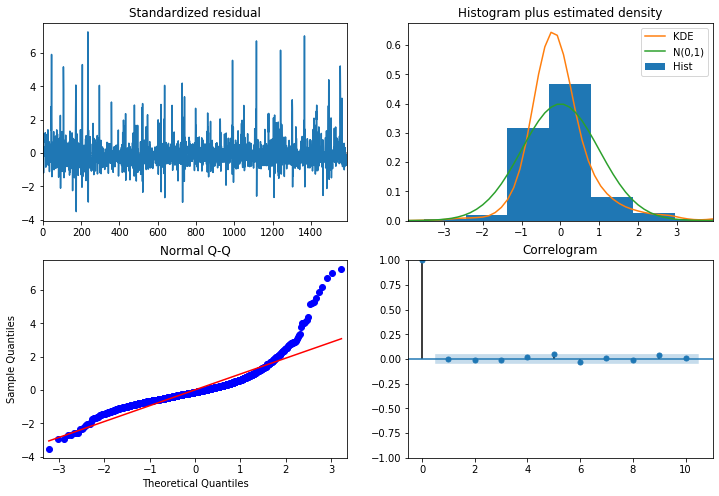

In [735]:
autosarima61.plot_diagnostics(figsize=(12,8));

In [736]:
# second try a model with m=63

autosarima63= pm.auto_arima(model1data, seasonal=True, m=63, stepwise=True,
                             d=1, max_d=1,
                             start_p=1, max_p=3,
                             start_q=1, max_q=3,
                             D=0, max_D=0,
                             start_P=0, max_P=3,
                             start_Q=0, max_Q=3,
                             suppress_warnings=True, error_action="ignore", max_order=None, trace=True,
                             with_intercept=False)

Performing stepwise search to minimize aic
Fit ARIMA: (1, 1, 1)x(0, 0, 0, 63) (constant=False); AIC=42019.815, BIC=42035.933, Time=1.037 seconds
Fit ARIMA: (0, 1, 0)x(0, 0, 0, 63) (constant=False); AIC=42269.054, BIC=42274.427, Time=0.064 seconds
Fit ARIMA: (1, 1, 0)x(1, 0, 0, 63) (constant=False); AIC=42186.204, BIC=42202.322, Time=14.984 seconds
Fit ARIMA: (0, 1, 1)x(0, 0, 1, 63) (constant=False); AIC=42147.822, BIC=42163.940, Time=17.242 seconds
Fit ARIMA: (1, 1, 1)x(1, 0, 0, 63) (constant=False); AIC=41970.087, BIC=41991.578, Time=40.506 seconds
Near non-invertible roots for order (1, 1, 1)(1, 0, 0, 63); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.994)
Fit ARIMA: (1, 1, 1)x(0, 0, 1, 63) (constant=False); AIC=41976.169, BIC=41997.660, Time=38.007 seconds
Near non-invertible roots for order (1, 1, 1)(0, 0, 1, 63); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.994)
Fit ARIMA: (1, 1, 1)x(1

In [737]:
autosarima63.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                                  y   No. Observations:                 1593
Model:             SARIMAX(1, 1, 1)x(1, 0, 1, 63)   Log Likelihood              -20931.282
Date:                            Mon, 27 Apr 2020   AIC                          41872.564
Time:                                    17:19:14   BIC                          41899.428
Sample:                                         0   HQIC                         41882.542
                                           - 1593                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5232      0.018     29.805      0.000       0.489       0.558
ma.L1         -0.9851      0.006   -159.196      0.000      -0.997      -0.973
ar.S.L63       0.9875      0.006    175.244      0.000       0.977       0.999
ma.S.L63      -0.9195      0.021    -44.296      0.000      -0.960      -0.879
sigma2      1.854e+10   4.81e-13   3.85e+22      0.000    1.85e+10    1.85e+10
===================================================================================
Ljung-Box (Q):                       79.37   Jarque-Bera (JB):              6884.51
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):               1.06   Skew:                             1.90
Prob(H) (two-sided):                  0.51   Kurtosis:                        12.46
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 8.62e+36. Standard errors may be unstable.
"""

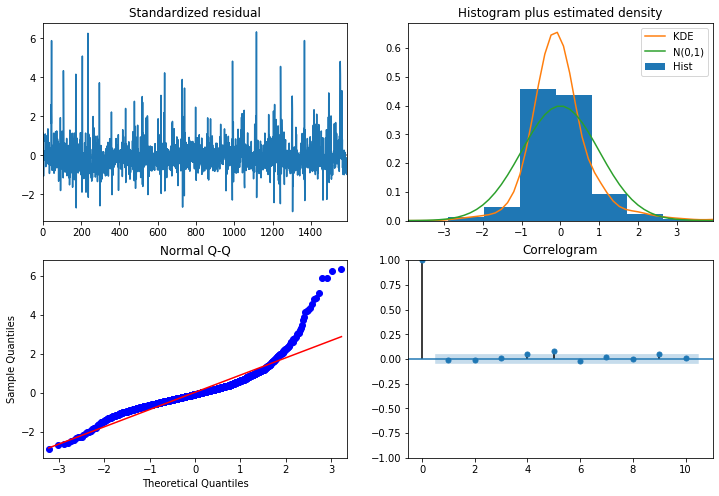

In [738]:
autosarima63.plot_diagnostics(figsize=(12,8));

<div class="alert alert-block alert-warning">
<h2><b>ARIMA vs SARIMA: how good a fit is each model?</b></h2>
<span style="color:black">   

There has been some small overall improvement when moving to a SARIMA model when you look at the aic scores.  

Just how good a fit each model really is can be determined by statistical measures of goodness of fit for each model's predicted values vs. actual results.

The three statistical methods I will use are:
- Root Mean Squared Error
- Mean Absolute Percentage Error &
- Symmetric Mean Absolute Percentage Error

<div class="alert alert-block alert-info">
<h2><b>Goodness of fit process</b></h2>
<span style="color:black">   

*The models have been built using all available datapoints. This is a simplistic approach since no data was held out for testing, but we can still perform the following three tests below to compare the model forecasts with the actual data*

The Root Mean Squared Error:  
$\large {RMSE = \sqrt{\frac{1}{n}\Sigma_{t=1}^{n}{\Big(\frac{A_t - F_t}{\sigma_i}\Big)^2}}}$

The Mean Absolute Percentage Error:  
$\large {MAPE = \frac  {1}{n}}\sum _{{t=1}}^{n}\left|{\frac  {A_{t}-F_{t}}{A_{t}}}\right|$<br>

The Symmetric Mean Absolute Percentage Error:  
$\large {SMAPE = \frac{100\%}{n}\sum_{t=1}^{n}{\frac{|F_{t}-A_{t}|}{(|A_{t}|+|F_{t}|)/2}}}$<br>
SMAPE is an accuracy measure based on percentage (or relative) errors, where a perfect SMAPE score is 0.0, and a higher score indicates a higher error rate.  


In [739]:
# Create in-model forecasts
AR1_values = auto.predict_in_sample()
SAR61_values = autosarima61.predict_in_sample()
SAR63_values = autosarima63.predict_in_sample()

# set the true values
ytrue = model1data.values
model_list = [auto, autosarima61, autosarima63]

# Generate all 3 statistical tests for each model
RMSE = [mean_squared_error(ytrue, mdl.predict_in_sample(), squared=False) for mdl in model_list]
MAPE = [mean_absolute_percentage_error(ytrue, mdl.predict_in_sample()) for mdl in model_list]
SMAPE = [smape(ytrue, mdl.predict_in_sample()) for mdl in model_list]

# Put those test results into a single dataframe for ease of viewing
results = pd.DataFrame((RMSE, MAPE, SMAPE), index=['RMSE','MAPE','SMAPE'], columns=['AR(1)', 'SAR(61)', 'SAR(63)']).T

In [740]:
# print the results
results

,RMSE,MAPE,SMAPE
AR(1),129763.727715,29.002600,25.370020
SAR(61),129655.527011,29.087296,25.355001
SAR(63),122789.770054,28.370801,24.730505


It is interesting to note that the SARIMA model where m=63 is quite different on these results to the other two, both of which are very similar.  
Just on the basis of these results it reinforces the SARIMA (m=63) model as the best fit for the data.  

***Later we will see if similar results occur with a more stringent predictive test***

## What do these (S)ARIMA models look like?

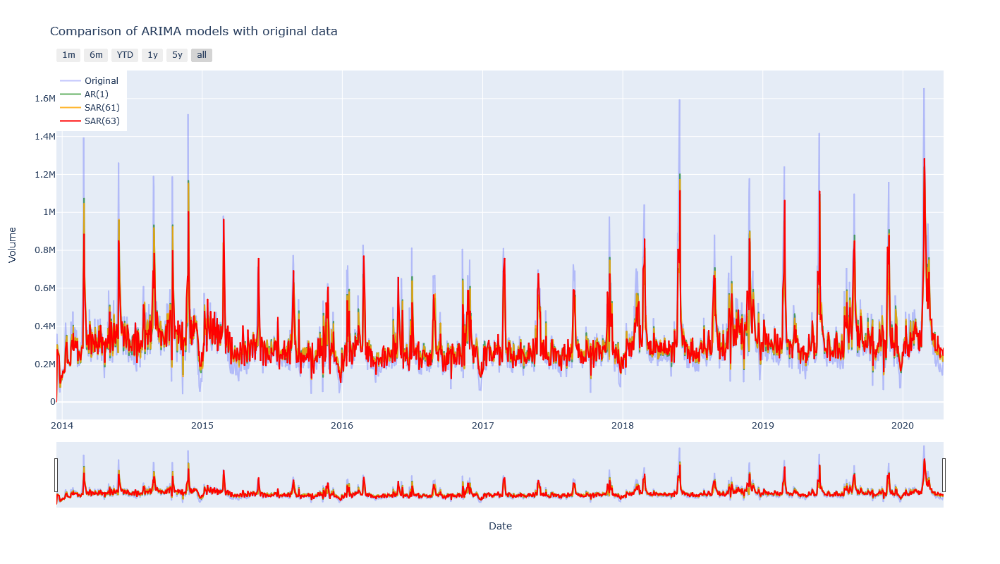

In [741]:

fig = plotly_base_fig(title='Comparison of ARIMA models with original data', 
                      xtitle='Date',
                      ytitle='Volume')

fig.add_scatter(x=model1data.index, y=model1data.values, mode='lines', name='Original', opacity=0.4)
fig.add_scatter(x=model1data.index, y=AR1_values, mode='lines', name='AR(1)', line_color='green', opacity=0.6)
fig.add_scatter(x=model1data.index, y=SAR61_values, mode='lines', name='SAR(61)', line_color='orange', opacity=0.8)
fig.add_scatter(x=model1data.index, y=SAR63_values, mode='lines', name='SAR(63)', line_color='red', opacity=1.0)

fig.show()

<div class="alert alert-block alert-info">
<h2><b>Outliers: What about detecting extreme events?</b></h2>
<span style="color:black">   

Let's define an extreme event as 2 standard deviations away from the mean.  Then re-run the tests only on those data points and see what the results are

In [747]:
modelmean = np.mean(model1data)
modelstd = np.std(model1data)

print('Mean:\t\t{:,.2f}\nStd Dev:\t{:,.2f}'.format(modelmean, modelstd))

Mean:		322,889.72
Std Dev:	180,252.62


In [755]:
# Create single dataframe with actual and predicted values
ARIMApredictions = pd.DataFrame({'Actual': model1data.values, 'AR(1)': AR1_values, 'SAR(61)': SAR61_values, 'SAR(63)': SAR63_values}, 
                                index=model1data.index)

In [756]:
ARIMApredictions.tail(5)

,Actual,AR(1),SAR(61),SAR(63)
Date,,,,
2020-04-09,178382.0,244565.748744,242117.868829,279527.810849
2020-04-13,139534.0,237756.416711,240287.242900,272514.459065
2020-04-14,188391.0,211913.588834,212381.099987,242776.097403
2020-04-15,228377.0,245161.603932,241948.555539,242866.935400
2020-04-16,224472.0,272302.505047,287830.055029,284472.522678


In [759]:
# Generate all 3 statistical tests for each model where the true values are > Mean + 2 * Standard Deviation

outliers = ARIMApredictions.loc[ARIMApredictions.Actual > modelmean + 2*modelstd, :]

cols = ['AR(1)', 'SAR(61)', 'SAR(63)']

RMSE2 = [mean_squared_error(outliers.Actual, outliers[col], squared=False) for col in cols]
MAPE2 = [mean_absolute_percentage_error(outliers.Actual, outliers[col]) for col in cols]
SMAPE2 = [smape(outliers.Actual, outliers[col]) for col in cols]

testresults = pd.DataFrame((RMSE2, MAPE2, SMAPE2), index=['RMSE','MAPE','SMAPE'], columns=['AR(1)', 'SAR(61)', 'SAR(63)']).T

In [760]:
testresults

,RMSE,MAPE,SMAPE
AR(1),403341.277737,34.844016,45.037971
SAR(61),403868.028859,34.939966,45.258034
SAR(63),366608.804480,30.278959,38.563624


<div class="alert alert-block alert-success">
<h2><b>Conclusion</b></h2>
<span style="color:black">   

The SAR(63) model is far more accurate than the other two models when comparing only the predicted vs actual values for extreme events.

<div class="alert alert-block alert-info">
<h2><b>Summary</b></h2>
<span style="color:black">   

I can build a model that visually fits the data.  Some element of seasonality can be included too which does improve the basic model.  
Extreme events are modelled but not the level of accuracy of other datapoints.
</span>
</div>

<div class="alert alert-block alert-danger">
<h2><b>Problem: overfitting of the model</b></h2>
<span style="color:black">   

This model has been fit vs. the entire dataset. A better test of its accuracy would be to split the time series into training and test sections, train the model on the first [80%] of the data and use that to predict the last [20%] then compare those results.

Even better than this would be to also cross-validate vs a moving window, however I don't have the computing power to run that for this model nor for multiple variations so this is presented more as an example of best practice!

### Train/Test 80:20

In [763]:
trainpct = 0.8
split=int(len(model1data) * trainpct) # Needs to be an integer because it is later used as an index.
train, test = model1data[0:split], model1data[split:]

In [764]:
len(model1data) == len(train) + len(test)

True

In [766]:
# use the SARIMA model with m=63
# build it with the train data

sarimamodel = pm.arima.ARIMA(order=autosarima63.order, 
                             seasonal_order=autosarima63.seasonal_order,
                             with_intercept=False)
sarimamodel.fit(train)


ARIMA(maxiter=50, method='lbfgs', order=(1, 1, 1), out_of_sample_size=0,
      scoring='mse', scoring_args=None, seasonal_order=(1, 0, 1, 63),
      start_params=None, suppress_warnings=False, trend=None,
      with_intercept=False)

In [968]:
def forecast_one_step(model, stepsize=1, conf_interval=True):
    """
    This function forecasts 'stepsize' step forwards of the given time series 'model' and returns the forecast and confidence intervals as two lists.
    
    Parameters:
    model: an ARIMA model from pmdarima built using a training set of data
    stepsize: how many steps forwards to forecast
    
    Return:
    list of forecasts, list of confidence intervals
    """
    fc, conf_int = model.predict(n_periods=stepsize, return_conf_int=conf_interval)
    return (fc.tolist()[0], conf_int.tolist()[0])

def forecast_all_steps(model, y_test, stepsize=1, conf_interval=True):
    """
    This function is used in conjunction with 'forecast_one_step' to rebuild the model after each 'stepsize' has been forecast.
    In that way, the model uses the forecast data to redefine itself, creating a more accurate representation of how it would be used in real life
    
    Parameters:
    model: an ARIMA model from pmdarima built using a training set of data
    stepsize: how many steps forwards to forecast
    y_test: the test set of data to forecast
    conf_interval: whether to return confidence intervals or not
    
    Return:
    A list of forecasts and confidence intervals
    """
    forecasts = list()
    confidence_intervals = list()
    testlen = len(y_test)
    t0 = time()
    out = Output()
    display(out)
    
    i=1
    for new_ob in y_test:
        out.clear_output()
        t1 = time()
        with out:
            print('Calculating forecast {} of {}'.format(i, testlen))
            print('Total time so far {:.2f} mins.'.format((t1-t0)/60))
        fc, conf = forecast_one_step(model, stepsize, conf_interval)
        forecasts.append(fc)
        confidence_intervals.append(conf)
        # Updates the existing model with a small number of MLE steps
        model.update(fc)
        i+=1
        
    return (forecasts, confidence_intervals)

In [768]:
# Get forecasts and confidence intervals for the new predictions

fc, ci = forecast_all_steps(sarimamodel, test)

Output()

In [769]:
print('Root mean squared error: {:.1f}'.format(mean_squared_error(test, fc, squared=False)))
print('MAPE: {:.1f}'.format(mean_absolute_percentage_error(test, fc)))
print('SMAPE: {:.1f}'.format(smape(test, fc)))

Root mean squared error: 132428.4
MAPE: 28.5
SMAPE: 24.5


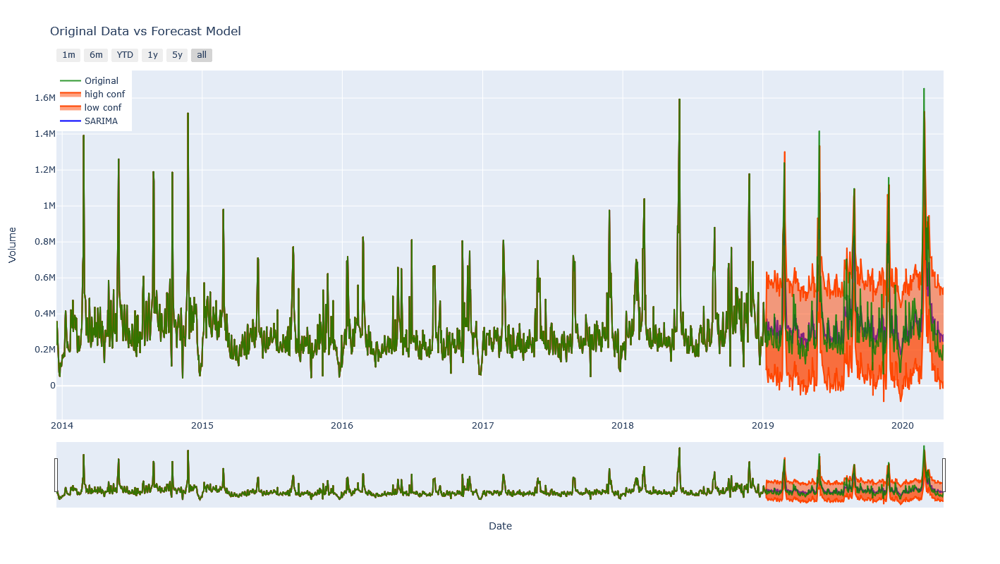

In [771]:
fig = plotly_base_fig(title='Original Data vs Forecast Model', 
                      xtitle='Date',
                      ytitle='Volume')
#fig = go.Figure()

fig.add_scatter(x=model1data.index, y=list(train.values)+fc, mode='lines', name='SARIMA', line_color='blue', opacity=0.8)
fig.add_scatter(x=model1data.index, y=list(train.values)+list(np.asarray(ci)[:,0]), mode='lines', name='low conf', line_color='orangered', opacity=1, fill='tonexty')
fig.add_scatter(x=model1data.index, y=list(train.values)+list(np.asarray(ci)[:,1]), mode='lines', name='high conf', line_color='orangered', opacity=1, fill='tonexty')
fig.add_scatter(x=model1data.index, y=model1data.values, mode='lines', name='Original', line_color='green', opacity=0.8)


fig.show()

<div class="alert alert-block alert-warning">
<h2><b>Viability of the SARIMA model</b></h2>
<span style="color:black">   


 - There is something strange here: the shape of the forecast appears to be in line with the real world, <u>but the results are all 1 day late.</u>  
 - The MAPE/SMAPE calculations also shows a 28.4% / 24.5% error respectively in the forecasts.  
     - that could be due to the high stochastic element of the model and thus might be as good as it gets!  
           
But, the reality is that an average error of 132,000 contracts is not that much and whilst the forecast at each peak is further away on average in terms of the absolute value than when the daily volume is closer to the mean, the fact that it identifies that one day or a few days of exceptional volume is likely is useful in itself.

<div class="alert alert-block alert-info">
<h2><b>SARIMA model forecasts</b></h2>
<span style="color:black">   

Forecast the SARIMA model for the next year. This is without any training data to compare too and will be useful when visually comparing with the next set of models using facebook Prophet

In [969]:
# rebuild the model on the full dataset
# reduce max_iter from 50 to 20 to speed it up
sarima_final = pm.arima.ARIMA(order=autosarima63.order, 
                             seasonal_order=autosarima63.seasonal_order,
                             with_intercept=False,
                             maxiter=20)
sarima_final.fit(model1data)


ARIMA(maxiter=20, method='lbfgs', order=(1, 1, 1), out_of_sample_size=0,
      scoring='mse', scoring_args=None, seasonal_order=(1, 0, 1, 63),
      start_params=None, suppress_warnings=False, trend=None,
      with_intercept=False)

In [970]:
# forecast 1 year forwards on weekdays only

forecast_dates = pd.bdate_range(start=model1data.index[-1]+pd.DateOffset(days=1), end=model1data.index[-1]+pd.DateOffset(days=365)).tolist()


In [971]:
fc_final, ci_final = forecast_all_steps(sarima_final, forecast_dates)

Output()

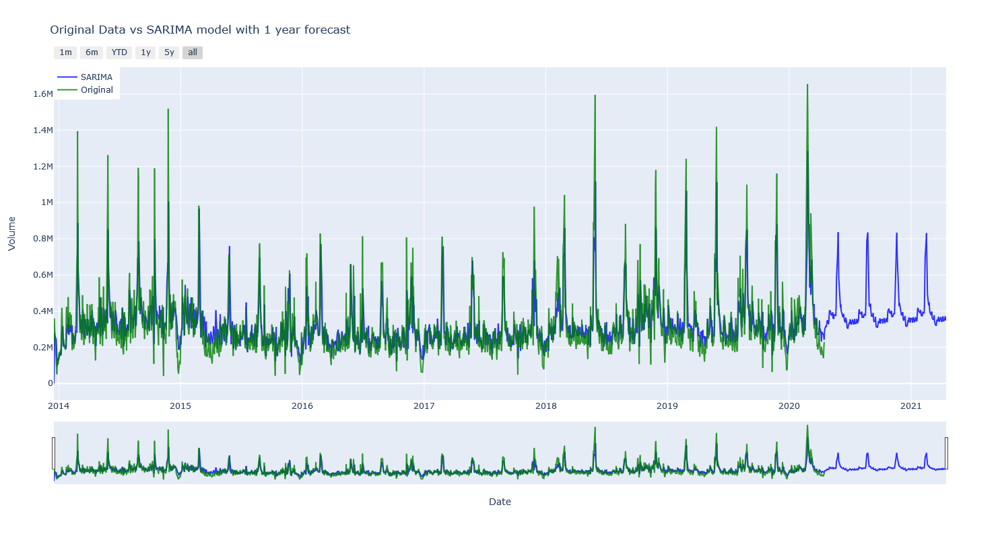

In [975]:
fig = plotly_base_fig(title='Original Data vs SARIMA model with 1 year forecast', 
                      xtitle='Date',
                      ytitle='Volume')
#fig = go.Figure()
xvals = list(model1data.index) + forecast_dates
ypred = sarima_final.predict_in_sample()

fig.add_scatter(x=xvals, y=ypred, mode='lines', name='SARIMA', line_color='blue', opacity=0.8)
# fig.add_scatter(x=model1data.index, y=list(train.values)+list(np.asarray(ci)[:,0]), mode='lines', name='low conf', line_color='orangered', opacity=1, fill='tonexty')
# fig.add_scatter(x=model1data.index, y=list(train.values)+list(np.asarray(ci)[:,1]), mode='lines', name='high conf', line_color='orangered', opacity=1, fill='tonexty')
fig.add_scatter(x=model1data.index, y=model1data.values, mode='lines', name='Original', line_color='green', opacity=0.8)


fig.show()

<div class="alert alert-block alert-info">

<h1><b>Model 3: Facebook Prophet Model</b></h1>
<span style="color:black">   

Facebook's Prophet time series model takes a different approach to the ARIMA model. Instead of fitting a model based upon a number of autocorrelation terms, it fits it with a series of Fourier Waves, in theory as many as you like. The model has many more hyperparameters to tune in order to find a 'best fit' and care should be taken to ensure that meaningful seasonalities are included and that the model is not overfit.  
    
It does though offer a different approach and one that is becoming more popular in recent discussions so it is worth exploring its capabilities and hopefully answer the question:  
    **"For these purposes which model is 'best' to use"**

Set up the data in the format required and build a first, base model using the built-in parameters

In [772]:
# Put data in the format required

fbdf = pd.DataFrame(model1data).reset_index()
fbdf.columns = ['ds','y']
fbdf.ds = pd.to_datetime(fbdf.ds)
# specify cap/floor for a logistic model. Cap is set very high, floor=0
#fbdf['cap'] = 2e6
#fbdf['floor'] = 0

In [773]:
fbdf[fbdf.ds=='2018-12-05'] # just confirming the one odd date is fixed

,ds,y
1250,2018-12-05,652805.0


In [799]:
Prophet_basemodel = fbp.Prophet(growth='linear', holidays=None)
Prophet_basemodel_2 = fbp.Prophet(growth='linear', holidays=None, uncertainty_samples=0) # for testing the speed of cv calculation
                    
# add US holidays
Prophet_basemodel.add_country_holidays(country_name='US')
Prophet_basemodel_2.add_country_holidays(country_name='US')

# Fit the model to the data
Prophet_basemodel.fit(fbdf)
Prophet_basemodel_2.fit(fbdf)


INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


<div class="alert alert-block alert-info">
<h3><b>Plot the base model</b></h3>    
<span style="color:black">   
    
Prophet comes with out-of-the-box plotting to include confidence intervals and significant changepoints (the orange bars)

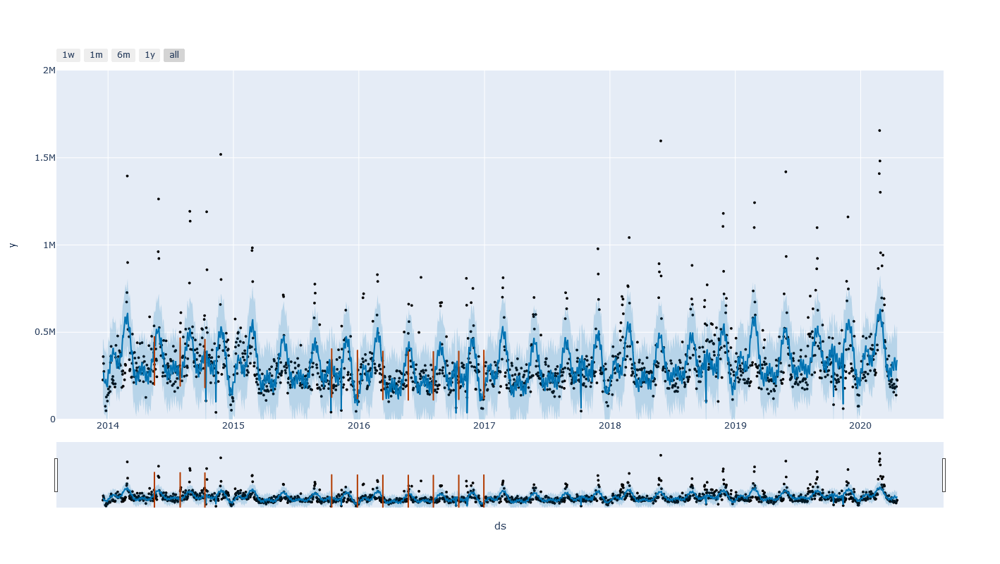

In [808]:
fig = plot_plotly(Prophet_basemodel, fcst=Prophet_basemodel.predict(), changepoints=True, changepoints_threshold=0.01)
fig.update_layout(height=800, width=1450, legend=dict(x=0, y=1))
fig.update_yaxes(range=[0, 2e6])
fig.show()


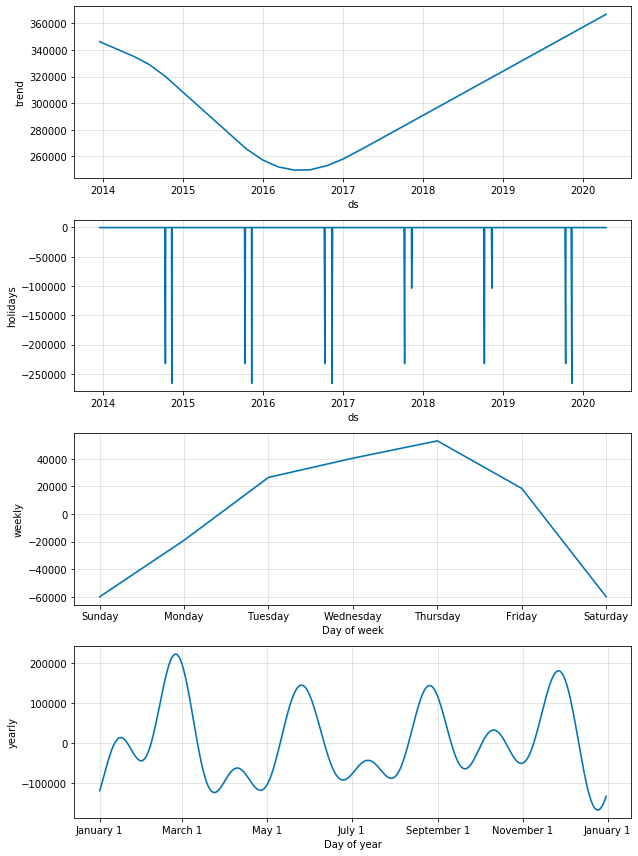

In [976]:
Prophet_basemodel.plot_components(Prophet_basemodel.predict());

<div class="alert alert-block alert-warning">
<h2><b>Summary, Base Prophet Model</b></h2>
<span style="color:black">   

A very quick model to create, the first graph shows the forecasts in blue along with the confidence interval in light blue and the actual history as the black dots. It has picked up the quarterly peaks in the volume although not the extent of them particularly for the final year.  It is also interesting to note that the confidence interval extends below zero although that is not possible in reality.  This can be overcome by setting a floor and cap to the prediction model but only if the series is assumed to be multiplicative rather than additive.  

The second set of graphs breaks the model down into its components:  
 - The trend component mighht have been expected to better align with the changepoints previously identified but the dip occurs about 2 years earlier
 - We can ignore the weekly component for Saturday and Sunday since there is never any activity on those days. The rest of the week varies from -20,000 to +50,000 with peak activity on a Thursday. Interesting, and maybe there is a some element of human behaviour to explain this, i.e. Fridays are just before the weekend and traders may be less active when there are 2 days of no trading to come which increases future uncertainty.
 - However, the weekly schedule is quite overwhelmed by the yearly one that ranges from ~-200,000 to +200,000. There are 4 main peaks here at roughly at the beginning of March, June, September and December which hit a trough 3 weeks later, roughly coinciding with when the front month contract has its last trading day. **That is interesting as it implies that the greatest trading activity is likely approximately 3 weeks before that date, every 3 months.  I expected it to be on or near to the last trading day.** This seasonality also ties in with the SARIMA model seasonality of 63 business days (i.e. every 3 months).  
 
Changepoints:  
The built-in changepoints identification assumes automatically there are 25 changepoints in the first 80% of the data. The first plot identifies these as the vertical, orange lines and shows that only 10 of them were significant enough to cause a 1% change. **This is another set of hyperparameters for later tuning**

<div class="alert alert-block alert-info">
<h2><b>Cross-Validation</b></h2>
<span style="color:black">   


Cross-validation is a more robust method of testing the accuracy of the model since multiple train/test splits are performed and their results typcially averaged. For time series models the split is done on a moving window of time.

Using the cross validation function from Prophet we get a dataframe of the predicted and true values for all our predicted points and can produce a list of performance metrics.  

The function requires us to pass the full tenor, fitted model and then specify:  
- horizon: the period being forecast
- period: how far forwards to move the cross-validation window
- initial: the initial period of training

**I shall use an intial period of 3 years, forecast for 6 months and roll it forwards by 3 months every time**

In [800]:
# create the cross-validation
t0 = time()
cv_results = cross_validation(Prophet_basemodel, initial='1096 days', period='91 days', horizon = '182 days')
t1 = time()
cv_results_base2 = cross_validation(Prophet_basemodel_2, initial='1096 days', period='91 days', horizon = '182 days')
t2 = time()

INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


In [802]:
print('Model\t\tTime to cross-validate\nbase\t\t{}\nbase2\t\t{}'.format(t1-t0, t2-t1))

Model		Time to cross-validate
base		63.50266933441162
base2		22.20302128791809


<div class="alert alert-block alert-success">
<h3><b>Note:</b></h3>
<span style="color:black">   

If we don't need the confidence intervals then the cross-validation is 3 times quicker to calculate. 

Therefore, if running a number of cross-validations to find an 'optimal' model it woudl be best to switch this off and then later rebuild the model with it on if needed

In [834]:
# get the performance stats for cross-validation
# rolling_window=0.10 means that we look at the stats from 10% of the horizon and increase by 1 day each time
cv_performance = performance_metrics(cv_results, rolling_window=0.10)
cv_performance

,horizon,mse,rmse,mae,mape,mdape,coverage
0,19 days,1.1994e+10,109518.9346,77770.3530,0.2694,0.2076,0.8824
1,20 days,1.3399e+10,115755.6209,82273.3023,0.2739,0.2345,0.8600
2,21 days,1.4313e+10,119637.5927,84800.9753,0.2687,0.2252,0.8567
3,22 days,1.4701e+10,121245.9300,84689.3799,0.2640,0.2169,0.8500
4,25 days,1.5284e+10,123629.4717,86847.1658,0.2882,0.2377,0.8400
...,...,...,...,...,...,...,...
113,176 days,1.0061e+10,100303.9972,79435.9330,0.3149,0.2484,0.9315
114,179 days,9.9206e+09,99602.2280,79158.4288,0.3248,0.2507,0.9382
115,180 days,1.0054e+10,100271.9739,80035.2547,0.3246,0.2505,0.9333
116,181 days,1.0390e+10,101932.0801,81513.5944,0.3309,0.2618,0.9267


<div class="alert alert-block alert-info">

<h2><b>Visualising the MAPE forecast error</b></h2>
<span style="color:black">   
    
We can plot the MAPE values for each forecast period and see how well the forecast works on average depending upon how far forward we are forecasting

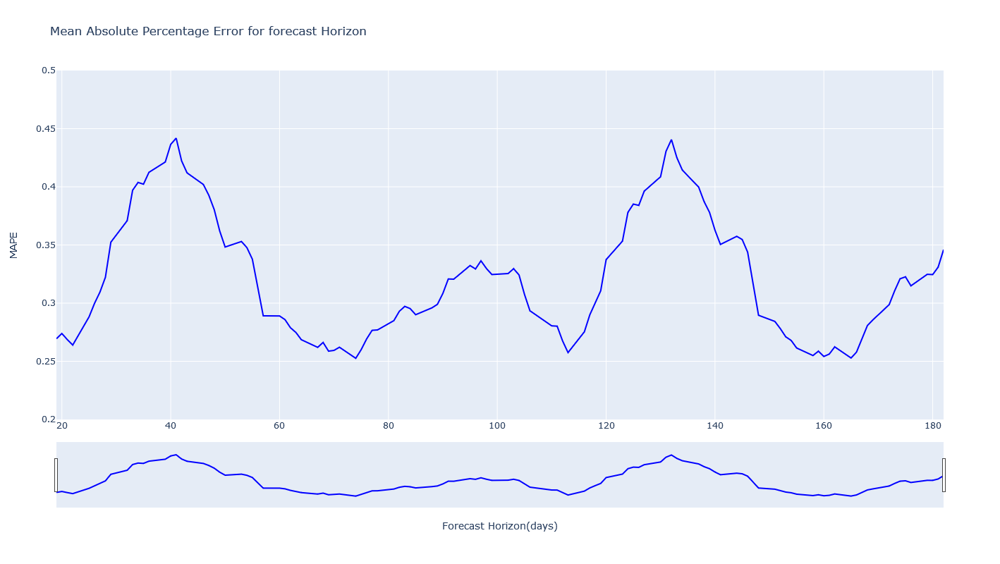

In [789]:
fig = plotly_base_fig(title='Mean Absolute Percentage Error for forecast Horizon', xtitle='Forecast Horizon(days)', ytitle='MAPE')
fig.add_scatter(x=cv_performance.horizon.dt.days, y=cv_performance.mape, mode='lines', name='MAPE-lin', line_color='blue', opacity=1.0)
#fig.add_scatter(x=cv_performance_log.horizon.dt.days, y=cv_performance_log.mape, mode='lines', name='MAPE-log', line_color='red', opacity=1.0)
fig.update_yaxes(range=[0.2, 0.5])
fig.show()

In [835]:
# overall stats:

performance_metrics(cv_results, rolling_window=1)

,horizon,mse,rmse,mae,mape,mdape,coverage
0,182 days,2.5435e+10,159482.702,106161.4835,0.3209,0.2542,0.8255


In [829]:
type(performance_metrics(cv_results, rolling_window=1))

pandas.core.frame.DataFrame

<div class="alert alert-block alert-warning">

<h2><b>Initial Comparison: Basic Prophet model vs. SARIMA</b></h2>
<span style="color:black">   

The two sets of statistics are not directly comparable with each other:
 - the SARIMA stats are based on a 80:20 train:test split
 - the Prophet stats are based on cross-validation up to 6 months forecasting for 12 forecast periods
 
Even though the RMSE & MAPE values are worse, the Prophet stats are determined in a more robust way. It is interesting to note that there is quite some variability in the overall accuracy of the forecasts depending on how far forwards we are forecasting. The plot perhaps indicates there are more, hidden seasonalities and better hyperparameters we can choose to smooth it out

<div class="alert alert-block alert-info">
<h1><b>Prophet model 2: adjust for changepoint prior scale</b></h1>    
<h2><b>A) Linear growth model</b></h2>
<span style="color:black">   

Before adding any bespoke seasonalities let's try various values for changepoint_prior_scale. This impacts the effect of changepoints with higher values allowing for a greater fit to the data. The significance of any changepoint is still a factor to the overall fit.  

What the 'right' number of changepoints is would be a matter for discussion with some domain experts. The PELT algorithm picked up on long-term changes and found only 2 in this timeframe, the Prophet model uses the number of changepoints, changepoint prior scale and seasonality factors in combination to better fit the data. **It is a question of the interpretability of the hyperparameters to the real world**

The three other hyperparameters we could also adjust that impact changepoints:
 1. changepoints: supply your own changepoint dates instead of having Prophet determine them itself
 2. n_changepoints: set the number of estimated changepoints
 3. changepoint_range: Proportion of history in which trend changepoints will be estimated. Defaults to 80%

In [809]:
changepoint_prior_scale_values = [0.05, 0.1, 0.5, 1, 5, 10]

# build all models and store in dictionary
Prophet_models = {'Prophet_cpp{}'.format(i): fbp.Prophet(growth='linear', 
                                                         holidays=None, 
                                                         changepoint_prior_scale=i, 
                                                         uncertainty_samples=0) 
                  for i in changepoint_prior_scale_values}
                 
# add US holidays & fit
for v in Prophet_models.values():
    v.add_country_holidays(country_name='US')
    v.fit(fbdf)


INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [810]:
cv_prophet_models = {k: cross_validation(v, initial='1096 days', period='91 days', horizon = '182 days') for k, v in Prophet_models.items()}

INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


In [811]:
cv_performances = {k: performance_metrics(v, rolling_window=0.1) for k, v in cv_prophet_models.items()}

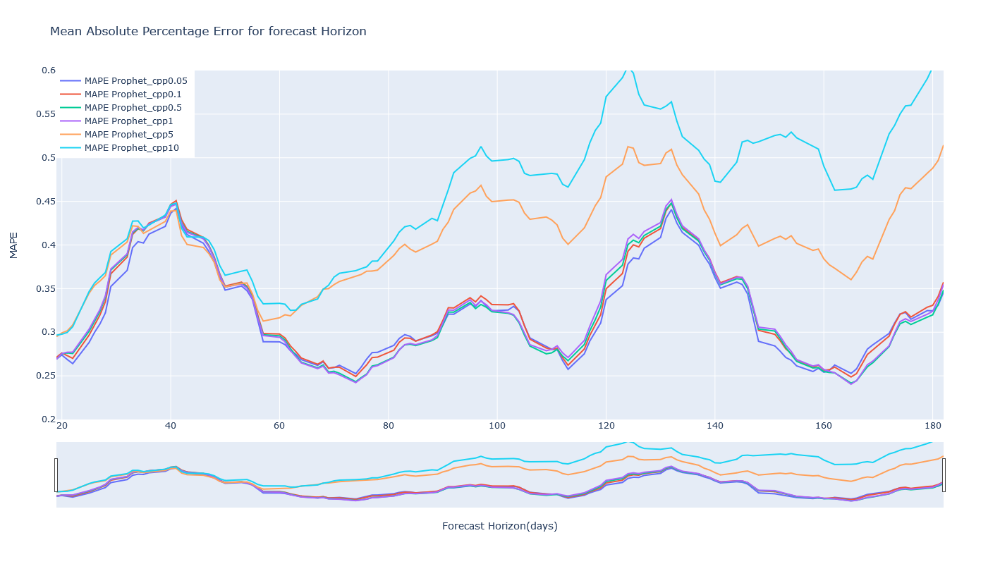

In [813]:
fig = plotly_base_fig(title='Mean Absolute Percentage Error for forecast Horizon', xtitle='Forecast Horizon(days)', ytitle='MAPE')
for k, v in cv_performances.items():
    fig.add_scatter(x=v.horizon.dt.days, y=v.mape, mode='lines', name='MAPE {}'.format(k))
fig.update_yaxes(range=[0.2, 0.6])
fig.show()

In [853]:
prophet_cvstats(cv_prophet_models)


,horizon,mse,rmse,mae,mape,mdape
Prophet_cpp0.05,182 days 00:00:00,25434732250.8801,159482.7020,106161.4835,0.3209,0.2542
Prophet_cpp0.1,182 days 00:00:00,25365121931.6884,159264.3147,106719.5873,0.3261,0.2585
Prophet_cpp0.5,182 days 00:00:00,25534429008.9699,159794.9593,106236.4005,0.3224,0.2539
Prophet_cpp1,182 days 00:00:00,25795179282.5854,160608.7771,106814.1839,0.3242,0.2570
Prophet_cpp5,182 days 00:00:00,33729661837.7431,183656.3689,127836.6646,0.4064,0.2982
Prophet_cpp10,182 days 00:00:00,38232257707.8609,195530.7078,139842.2907,0.4582,0.3257


<div class="alert alert-block alert-info">

<h2><b>B) Logistic growth model</b></h2>
<span style="color:black">   

We've already seen that the confidence interval for a linear model stretches below zero, so maybe a logistic model with a floor at zero is a practical alternative.  

I'm going to build various cross-validated models again assuming a logistic growth pattern and compare that to the linear model

In [846]:
changepoint_prior_scale_values2 = [0.05, 0.1, 0.5, 1]

# specify cap/floor for a logistic model. Cap is set very high, floor=0
fbdf2 = fbdf.copy()
fbdf2['cap'] = 2e6
fbdf2['floor'] = 0

# build all models and store in dictionary
Prophet_models_log = {'Prophet_cpp{}'.format(i): fbp.Prophet(growth='logistic', 
                                                         holidays=None, 
                                                         changepoint_prior_scale=i, 
                                                         uncertainty_samples=0) 
                  for i in changepoint_prior_scale_values2}
                 
# add US holidays & fit
for v in Prophet_models_log.values():
    v.add_country_holidays(country_name='US')
    v.fit(fbdf2)


INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [847]:
cv_prophet_models_log = {k: cross_validation(v, initial='1096 days', period='91 days', horizon = '182 days') for k, v in Prophet_models_log.items()}

INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


In [854]:
cv_performances_log = {k: performance_metrics(v, rolling_window=0.1) for k, v in cv_prophet_models_log.items()}

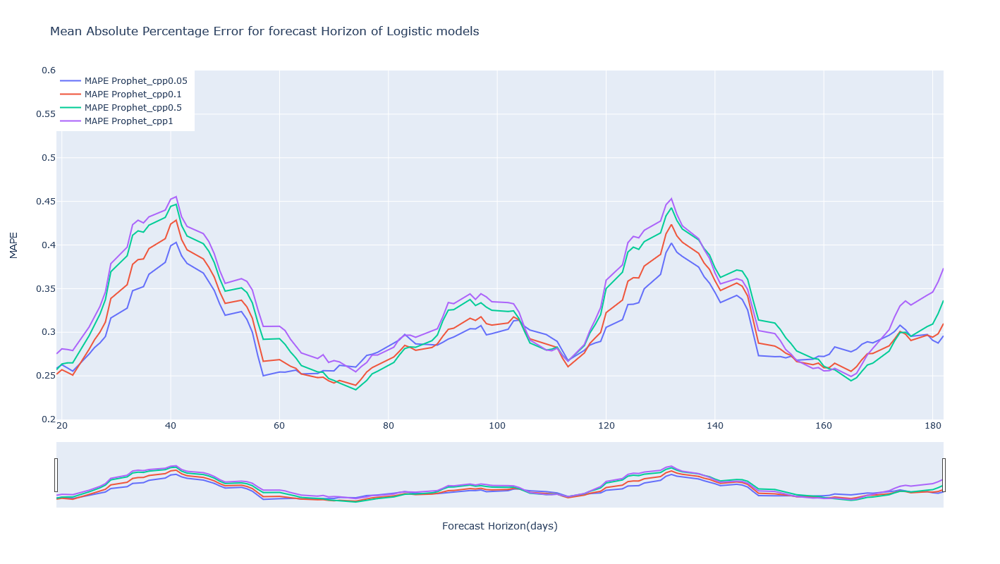

In [856]:
fig = plotly_base_fig(title='Mean Absolute Percentage Error for forecast Horizon of Logistic models', xtitle='Forecast Horizon(days)', ytitle='MAPE')
for k, v in cv_performances_log.items():
    fig.add_scatter(x=v.horizon.dt.days, y=v.mape, mode='lines', name='MAPE {}'.format(k))
fig.update_yaxes(range=[0.2, 0.6])
fig.show()

In [952]:
print('Logistic growth model stats\n')
prophet_cvstats(cv_prophet_models_log)

Logistic growth model stats



,horizon,mse,rmse,mae,mape,mdape
Prophet_cpp0.05,182 days 00:00:00,26628879923.8967,163183.5774,105325.5746,0.3016,0.2519
Prophet_cpp0.1,182 days 00:00:00,25875507854.9342,160858.6580,104659.4731,0.3069,0.2506
Prophet_cpp0.5,182 days 00:00:00,25649193648.8358,160153.6564,106068.6020,0.3196,0.2590
Prophet_cpp1,182 days 00:00:00,25416842109.4302,159426.6041,107477.8567,0.3309,0.2585


In [972]:
print('Linear growth model stats\n')
prophet_cvstats(cv_prophet_models)

Linear growth model stats



,horizon,mse,rmse,mae,mape,mdape
Prophet_cpp0.05,182 days 00:00:00,25434732250.8801,159482.7020,106161.4835,0.3209,0.2542
Prophet_cpp0.1,182 days 00:00:00,25365121931.6884,159264.3147,106719.5873,0.3261,0.2585
Prophet_cpp0.5,182 days 00:00:00,25534429008.9699,159794.9593,106236.4005,0.3224,0.2539
Prophet_cpp1,182 days 00:00:00,25795179282.5854,160608.7771,106814.1839,0.3242,0.2570
Prophet_cpp5,182 days 00:00:00,33729661837.7431,183656.3689,127836.6646,0.4064,0.2982
Prophet_cpp10,182 days 00:00:00,38232257707.8609,195530.7078,139842.2907,0.4582,0.3257


<div class="alert alert-block alert-warning">

<span style="color:black">   

The two models where changepoint_prior_scale is 0.05 appear to be the 'best fit' on the basis of the MAPE score although the logistic model outperforms the linear model by 1.95%.  
The RMSE is slightly ini favour of the linear model but the difference is also just 2.3%  
    
It would be good to compare their forecasts vs. the actual datapoints too

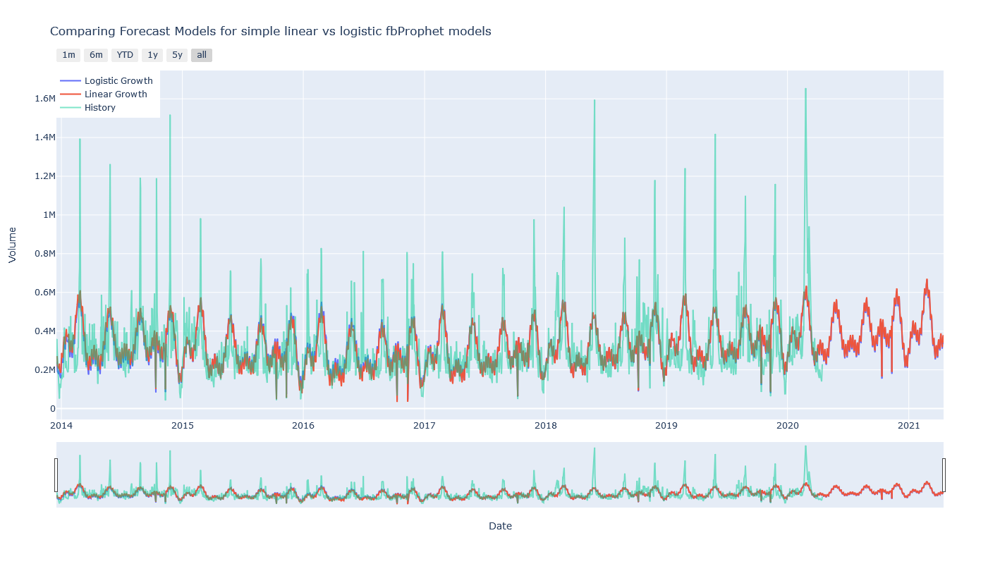

In [950]:
fig = plotly_base_fig('Comparing Forecast Models for simple linear vs logistic fbProphet models', 'Date', 'Volume')

# don't forget to remove the weekends or the predictions look far more volatile than they really are!!!
linpredict = Prophet_models['Prophet_cpp0.05'].predict(remove_weekends(Prophet_models['Prophet_cpp0.05'].make_future_dataframe(periods=365)))
log_fut_df = remove_weekends(Prophet_models_log['Prophet_cpp0.05'].make_future_dataframe(periods=365))
log_fut_df['floor']=0
log_fut_df['cap']=2e6
logpredict = Prophet_models_log['Prophet_cpp0.05'].predict(log_fut_df)

fig.add_scatter(x=logpredict.ds, y=logpredict.yhat, mode='lines', name='Logistic Growth')
fig.add_scatter(x=linpredict.ds, y=linpredict.yhat, mode='lines', name='Linear Growth')
fig.add_scatter(x=fbdf.ds, y=fbdf.y, mode='lines', name='History', opacity=0.5)

fig.show()

<div class="alert alert-block alert-success">

<h2><b>Conclusions so far</b></h2>
<span style="color:black">   

 - The lowest values for changepoint_prior_scale have a better fit and depending upon which goodness of fit statistic you choose would determine which model to pick although there is not much to choose between them.  
 - On the same basis, the logistic growth model also outperforms the linear growth model
 - **There really isn't anything much to choose between themm**

***Moving forwards, I will go with cpp = 0.05 and a linear model looking to optimise the parameters to minimise the Mean Absolute Percentage Error and try to build a better model by adding bespoke seasonalities.  I've chose a linear model even though the logistic one has slightly better data fit because my experience of the market tells me that the growth rate is linear, not logistic***


<div class="alert alert-block alert-info">

<h2><b>Prophet model 3: Adjust seasonality</b></h2>
<span style="color:black">   

1) Remove the built-in seasonalities and add a weekly, monthly, quarterly and annual seasonality  
2) Test with different fourier_order values for each
    
This is manually determined model, hyperparameters have been randomnly chosen to see the effects of bespoke seasonalities

In [873]:
seasonality_prior_scale_values = [0.1, 1, 5, 10, 15, 20, 25]
fourier_orders = [5, 10, 15, 20, 25]

Prophet_seas1 = fbp.Prophet(growth='linear', 
                              holidays=None, 
                              changepoint_prior_scale=0.05,
                              daily_seasonality=False,
                              weekly_seasonality=False,
                              yearly_seasonality=False,
                              uncertainty_samples=0
                              ).add_seasonality(
                                  name='monthly',
                                  period=30.5,
                                  fourier_order=10,
                                  prior_scale=10
                              ).add_seasonality(
                                  name='quarterly',
                                  period=365.25/4,
                                  fourier_order=10,
                                  prior_scale=20
                              ).add_seasonality(
                                  name='yearly',
                                  period=365.25,
                                  fourier_order=5,
                                  prior_scale=10
                              )

                 
# add US holidays & fit
Prophet_seas1.add_country_holidays(country_name='US')
Prophet_seas1.fit(fbdf)


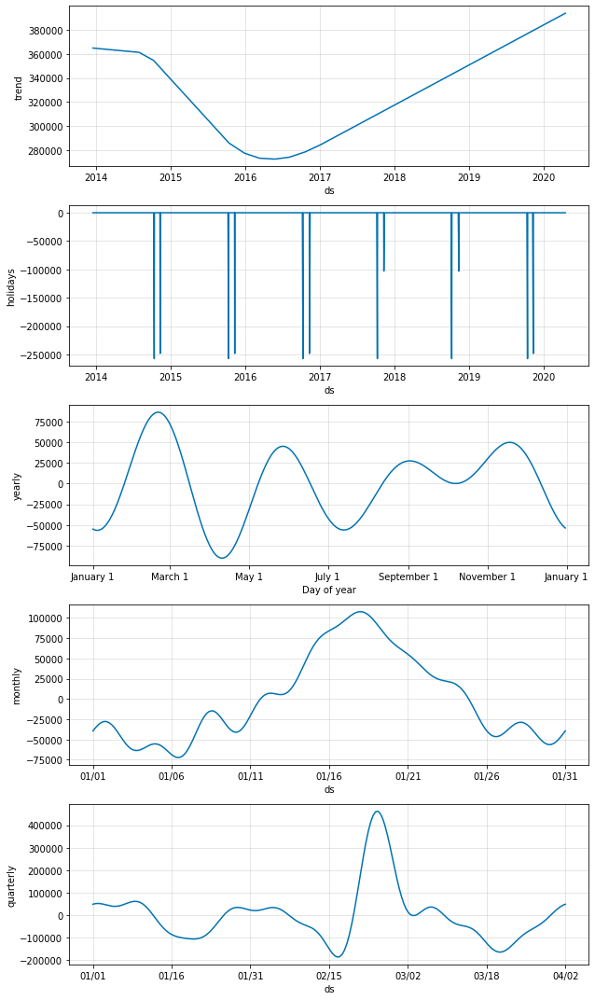

In [888]:
Prophet_seas1.plot_components(Prophet_seas1.predict());


<div class="alert alert-block alert-warning">
<h2><b>Comparison of Prophet models 2 & 3</b></h2>
<span style="color:black">   

Comparing these graphs to the previous ones from the basic model, it does appear that:
- the yearly seasonality has reduced a lot in range to \~ -80,000 to +80,000 but with a similar shape
- the monthly seasonality has a similar range to the yearly but with a strong positive impact in the middle of the month an almost as strong negative impact in the remainder
- the quarterly seasonality however has become much more significant ranging between -200,000 to +500,000 with a pronounced peak after 2.5 months. This actually ties up with the previous yearly seasonality

**I will run the same cross-validation process and plot the rolling cross-validation MAPE score and compare the predictions graphically**

In [889]:
cv_Prophet_seas1 = cross_validation(Prophet_seas1, initial='1096 days', period='91 days', horizon = '182 days')

INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


In [890]:
cv_performances_seas1 = performance_metrics(cv_Prophet_seas1, rolling_window=0.1)

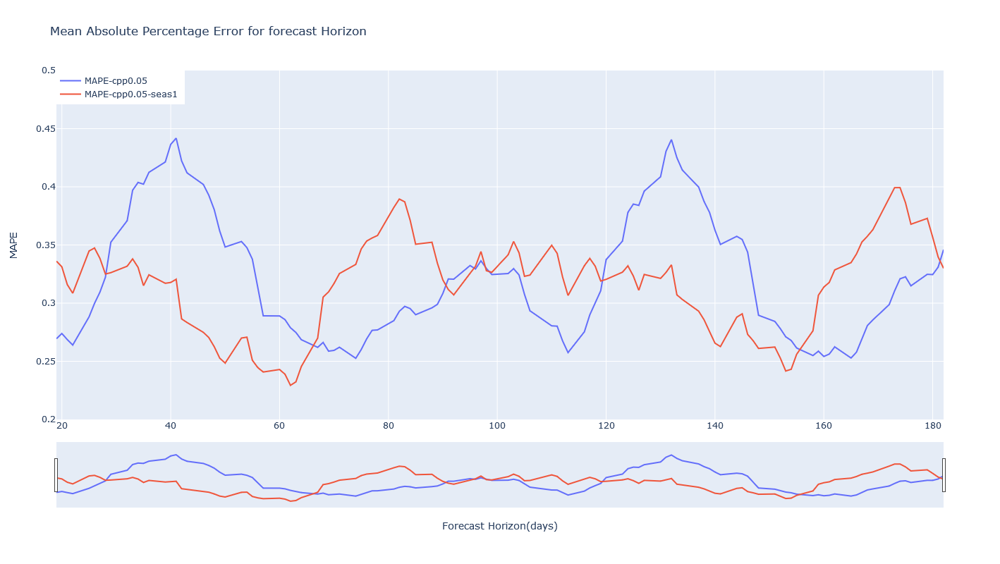

In [891]:
fig = plotly_base_fig(title='Mean Absolute Percentage Error for forecast Horizon', xtitle='Forecast Horizon(days)', ytitle='MAPE')
fig.add_scatter(x=cv_performances['Prophet_cpp0.05'].horizon.dt.days, y=cv_performances['Prophet_cpp0.05'].mape, mode='lines', name='MAPE-cpp0.05')
fig.add_scatter(x=cv_performances_seas1.horizon.dt.days, y=cv_performances_seas1.mape, mode='lines', name='MAPE-cpp0.05-seas1')
#fig.add_scatter(x=cv_performance_log.horizon.dt.days, y=cv_performance_log.mape, mode='lines', name='MAPE-log', line_color='red', opacity=1.0)
fig.update_yaxes(range=[0.2, 0.5])
fig.show()

In [892]:
# Base model performance
performance_metrics(cv_prophet_models['Prophet_cpp0.05'], rolling_window=1)

,horizon,mse,rmse,mae,mape,mdape
0,182 days,2.5435e+10,159482.702,106161.4835,0.3209,0.2542


In [893]:
# Seasonality adjusted model performance
performance_metrics(cv_Prophet_seas1, rolling_window=1)

,horizon,mse,rmse,mae,mape,mdape
0,182 days,1.7645e+10,132832.7932,95335.5725,0.3163,0.242


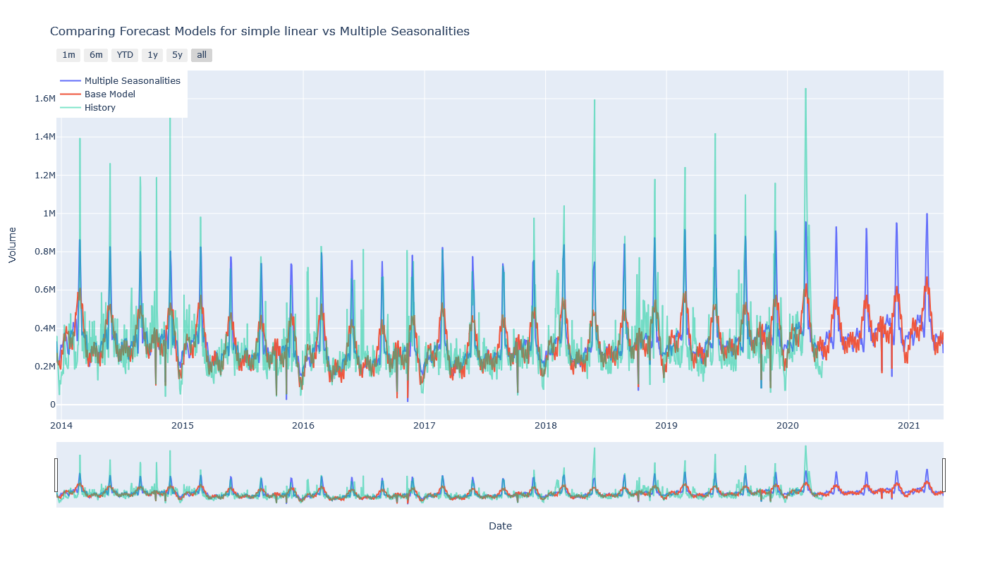

In [953]:
fig = plotly_base_fig('Comparing Forecast Models for simple linear vs Multiple Seasonalities', 'Date', 'Volume')

seaspredict1 = Prophet_seas1.predict(remove_weekends(Prophet_seas1.make_future_dataframe(periods=365)))

fig.add_scatter(x=seaspredict1.ds, y=seaspredict1.yhat, mode='lines', name='Multiple Seasonalities')
fig.add_scatter(x=linpredict.ds, y=linpredict.yhat, mode='lines', name='Base Model')
fig.add_scatter(x=fbdf.ds, y=fbdf.y, mode='lines', name='History', opacity=0.5)

fig.show()

<div class="alert alert-block alert-warning">
<h2><b>Summary</b></h2>
<span style="color:black"> 

- MAPE has reduced a little, but the RMSE has come down nearly 17% to almost the same value as the SARIMA model
- The forecasts have much more pronounced peaks far more in line with the historical data
- It still captures the variance between these peaks though perhaps not to the same extent
- There is still a lot of regularity in the model predictions. Changes in the underlying that don't match this regularity in the historical data (for example Feb-2016, Jan-2018, Oct/Nov-2018) are not picked up by either model

**If our primary goal is to better predict sudden peaks in volume then so far either of the SARIMA or this latest Prophet model are adequate**

<div class="alert alert-block alert-info">
<h2><b>Prophet Model 4: Hyperparameter Tuning</b></h2>
    <h3>Apply HyperOpt (a baysian search method to optimise parameters)</h3>
        <span style="color:black"> 

In order to determine the 'best' hyperparameters for a closer fit we could continue to guess, perform a grid search over all parameters or use a method that tries to find the optimal set of parameters within a clearly defined search space according to some optimisation algorithm.  

Given the vast number of possible choices I have decided to go with the latter option and implement using the hyperopt package for this purpose. First I will prove it on a simple version of the Prophet model and then extend it to cover the multiple seasonalities we have already defined.  

It is worth noting that this will not necessarily produce the best fitting set of parameters, that would require a massive search space and a lot of time, but given a set of limmitations and a reasonable number of iterations it will come up with a good approximation.  

I will build a specialist Class that takes in the parameters, their potential range spaces, build the Prophet model and runs the cross-validation for each option seeking to optimise (i.e. minimise) the MAPE result of this.

<u>Referece sources:</u>  
https://medium.com/machine-learning-eli5/cross-validation-the-right-way-386839ed39b1  
https://hyperopt.github.io/hyperopt/

In [897]:
from hyperopt import fmin, tpe, hp, space_eval, Trials, STATUS_OK

In [914]:
class ModelTraining:
    """
    This is a basic class that creates an optimisation function compatible with hyperopt and applies it to a facebook prophet model through cross-validation
    This version works with a single set of model parameters and multiple additional seasonalities. 
    
    Import Assumptions:
    'import fbprophet as fbp'
    'from fbprophet.diagnostics import cross_validation, performance_metrics'
    'from hyperopt import fmin, tpe, hp, space_eval, Trials, STATUS_OK'
    
    Parameters:
    --------------
    data: a fbProphet compliant dataframe
    fbp_model_params: a dictionary of parameters for the fbProphet model
    n_trials: the number of trials to run the fmin for
    cv_params: a dictionary of parameters for the cross_validations function
    seasonality_params: a dictionary of dictionaries. Each sub-dictionary is the parameters for each seasonality added to the Prophet class model via .add_seasonality
    
    Usage:
    Initialise the model, then output the 'optimize' method to run the fmin optimisation function.
    Detailed results are available in the .trials class parameter
    """

    def __init__(self, data, fbp_model_params, n_trials, cv_params, seasonality_params=None):

        self.data = data
        self.test = test 
        self.fbp_model_params = fbp_model_params
        self.seas_params = seasonality_params
        self.params = {'model': self.fbp_model_params, 'seasonality': self.seas_params} #self.fbp_model_params # will be {**fbp_model_params, **seasonality_params}
        self.n_trials = n_trials
        self.cv_params = cv_params
        self.trials = Trials()

    def _objective(self, params):
        estimator = fbp.Prophet(**params['model'])  #fbp.Prophet(**params)
        
        # only add seasonality if it is passed in
        if self.seas_params:
            for season in params['seasonality'].values():
                estimator.add_seasonality(**season)
        
        estimator.add_country_holidays(country_name='US')
        estimator.fit(self.data)
        cv = cross_validation(estimator, **self.cv_params) # initial='1096 days', period='91 days', horizon = '182 days')
        score = performance_metrics(cv, rolling_window=1).mape[0]
        return {'loss': score,
                'status': STATUS_OK,
                'model_params': params['model'], 
                'seasonality_params': params['seasonality']
               }
        
    def optimize(self):
        return fmin(self._objective,
                    self.params,
                    algo=tpe.suggest,
                    max_evals=self.n_trials,
                    trials=self.trials,
                    rstate=np.random.RandomState(42),
                    verbose=True)

<div class="alert alert-block alert-info">
<h2><b>Optimisation 1: basic fbProphet model</b></h2>
<span style="color:black"> 

A basic model with just the option of the built-in seasonality. Testing whether to include or exclude the seasonality and a range of values for changepoint_prior_scale.  

This is just to test the first iteration of the hyperparameter tuning class

In [904]:
param_space = {'growth': 'linear', 
               'holidays': None, 
               'changepoint_prior_scale': hp.uniform('changepoint_prior_scale', 0.01, 1),
               'daily_seasonality': hp.choice('daily_seasonality', [True, False]),
               'weekly_seasonality': hp.choice('weekly_seasonality', [True, False]),
               'yearly_seasonality': hp.choice('yearly_seasonality', [True, False]),
               'uncertainty_samples': 0
              }

In [905]:
cv_param_space = {'initial': '1096 days', 'period': '91 days', 'horizon': '182 days'}

In [906]:
model_training = ModelTraining(data=fbdf,
                               fbp_model_params=param_space, 
                               n_trials=50, 
                               cv_params=cv_param_space)

In [907]:
best_params = model_training.optimize()

  0%|          | 0/50 [00:00<?, ?trial/s, best loss=?]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 0 trials
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  2%|▏         | 1/50 [00:51<42:26, 51.97s/trial, best loss: 0.3762611883359764]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 1/1 trials with best loss 0.376261
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  4%|▍         | 2/50 [01:49<42:58, 53.72s/trial, best loss: 0.3369055350124048]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 2/2 trials with best loss 0.336906
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  6%|▌         | 3/50 [03:01<46:24, 59.25s/trial, best loss: 0.3227993391941189]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 3/3 trials with best loss 0.322799
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  8%|▊         | 4/50 [03:49<42:50, 55.89s/trial, best loss: 0.3227993391941189]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 4/4 trials with best loss 0.322799
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 10%|█         | 5/50 [04:37<40:03, 53.42s/trial, best loss: 0.3227993391941189]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 5/5 trials with best loss 0.322799
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 12%|█▏        | 6/50 [05:02<32:55, 44.89s/trial, best loss: 0.3227993391941189]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 6/6 trials with best loss 0.322799
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 14%|█▍        | 7/50 [06:11<37:15, 51.99s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015641 seconds
INFO:hyperopt.tpe:TPE using 7/7 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 16%|█▌        | 8/50 [06:51<34:02, 48.62s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 8/8 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 18%|█▊        | 9/50 [07:22<29:29, 43.16s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 9/9 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 20%|██        | 10/50 [08:01<28:00, 42.02s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 10/10 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 22%|██▏       | 11/50 [08:27<24:07, 37.10s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015626 seconds
INFO:hyperopt.tpe:TPE using 11/11 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 24%|██▍       | 12/50 [09:21<26:47, 42.31s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015609 seconds
INFO:hyperopt.tpe:TPE using 12/12 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 26%|██▌       | 13/50 [10:17<28:33, 46.32s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 13/13 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 28%|██▊       | 14/50 [10:39<23:21, 38.94s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 14/14 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 30%|███       | 15/50 [11:08<21:06, 36.18s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 15/15 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 32%|███▏      | 16/50 [11:55<22:14, 39.24s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 16/16 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 34%|███▍      | 17/50 [12:24<19:54, 36.19s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 17/17 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 36%|███▌      | 18/50 [13:49<27:08, 50.89s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 18/18 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 38%|███▊      | 19/50 [14:40<26:16, 50.85s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 19/19 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 40%|████      | 20/50 [15:49<28:08, 56.27s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 20/20 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 42%|████▏     | 21/50 [16:55<28:37, 59.21s/trial, best loss: 0.3227114938893567]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 21/21 trials with best loss 0.322711
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 44%|████▍     | 22/50 [17:30<24:15, 51.97s/trial, best loss: 0.32258862227725416]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 22/22 trials with best loss 0.322589
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 46%|████▌     | 23/50 [17:53<19:29, 43.30s/trial, best loss: 0.3134988126657348] 

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 23/23 trials with best loss 0.313499
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 48%|████▊     | 24/50 [18:14<15:54, 36.73s/trial, best loss: 0.31309715341874805]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 24/24 trials with best loss 0.313097
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 50%|█████     | 25/50 [18:37<13:35, 32.62s/trial, best loss: 0.31309715341874805]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 25/25 trials with best loss 0.313097
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 52%|█████▏    | 26/50 [18:57<11:28, 28.68s/trial, best loss: 0.31309715341874805]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.017383 seconds
INFO:hyperopt.tpe:TPE using 26/26 trials with best loss 0.313097
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 54%|█████▍    | 27/50 [19:10<09:09, 23.87s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 27/27 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 56%|█████▌    | 28/50 [19:45<10:03, 27.43s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 28/28 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 58%|█████▊    | 29/50 [20:22<10:33, 30.16s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 29/29 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 60%|██████    | 30/50 [20:44<09:16, 27.81s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 30/30 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 62%|██████▏   | 31/50 [21:16<09:09, 28.94s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 31/31 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 64%|██████▍   | 32/50 [21:56<09:41, 32.32s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 32/32 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 66%|██████▌   | 33/50 [22:54<11:18, 39.94s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 33/33 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 68%|██████▊   | 34/50 [23:55<12:22, 46.42s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 34/34 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 70%|███████   | 35/50 [24:13<09:27, 37.84s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015620 seconds
INFO:hyperopt.tpe:TPE using 35/35 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 72%|███████▏  | 36/50 [24:43<08:16, 35.44s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 36/36 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 74%|███████▍  | 37/50 [25:28<08:18, 38.34s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 37/37 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 76%|███████▌  | 38/50 [26:26<08:49, 44.12s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 38/38 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 78%|███████▊  | 39/50 [27:21<08:41, 47.45s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 39/39 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 80%|████████  | 40/50 [27:52<07:04, 42.48s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 40/40 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 82%|████████▏ | 41/50 [28:26<06:01, 40.18s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015621 seconds
INFO:hyperopt.tpe:TPE using 41/41 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 84%|████████▍ | 42/50 [28:59<05:04, 38.01s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 42/42 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 86%|████████▌ | 43/50 [29:37<04:25, 37.88s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 43/43 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 88%|████████▊ | 44/50 [30:02<03:24, 34.05s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 44/44 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 90%|█████████ | 45/50 [30:35<02:48, 33.67s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 45/45 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 92%|█████████▏| 46/50 [31:19<02:26, 36.70s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 46/46 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 94%|█████████▍| 47/50 [31:59<01:53, 37.68s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 47/47 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 96%|█████████▌| 48/50 [32:59<01:28, 44.45s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 48/48 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 98%|█████████▊| 49/50 [33:15<00:35, 35.88s/trial, best loss: 0.30959444164440997]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 49/49 trials with best loss 0.309594
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


100%|██████████| 50/50 [33:55<00:00, 40.72s/trial, best loss: 0.30959444164440997]


In [908]:
space_eval(param_space, best_params)

{'changepoint_prior_scale': 0.01521392516847115,
 'daily_seasonality': False,
 'growth': 'linear',
 'holidays': None,
 'uncertainty_samples': 0,
 'weekly_seasonality': True,
 'yearly_seasonality': True}

The former run of this had these results:  
{'changepoint_prior_scale': 0.011364495942816157,
 'daily_seasonality': True,
 'growth': 'linear',
 'holidays': None,
 'weekly_seasonality': True,
 'yearly_seasonality': True}

In [909]:
model_training.trials.best_trial

{'state': 2,
 'tid': 26,
 'spec': None,
 'result': {'loss': 0.30959444164440997,
  'status': 'ok',
  'model_params': {'changepoint_prior_scale': 0.01521392516847115,
   'daily_seasonality': False,
   'growth': 'linear',
   'holidays': None,
   'uncertainty_samples': 0,
   'weekly_seasonality': True,
   'yearly_seasonality': True},
  'seasonality_params': None},
 'misc': {'tid': 26,
  'cmd': ('domain_attachment', 'FMinIter_Domain'),
  'workdir': None,
  'idxs': {'changepoint_prior_scale': [26],
   'daily_seasonality': [26],
   'weekly_seasonality': [26],
   'yearly_seasonality': [26]},
  'vals': {'changepoint_prior_scale': [0.01521392516847115],
   'daily_seasonality': [1],
   'weekly_seasonality': [0],
   'yearly_seasonality': [0]}},
 'exp_key': None,
 'owner': None,
 'version': 0,
 'book_time': datetime.datetime(2020, 4, 28, 18, 8, 48, 325000),
 'refresh_time': datetime.datetime(2020, 4, 28, 18, 9, 0, 945000)}

<div class="alert alert-block alert-info">
<h2><b>Optimisation 2: basic fbProphet model, no built-in seasonality, monthly seasonality added</b></h2>
<span style="color:black"> 

Turning off the built-in seasonality and adding just one monthly seasonality.  
Optimising for changepoint_prior_scale on the main Prophet model and fourier_order, prior_scale on the monthly seasonality.  
Also testing if the monthly seasonality should be additive or multiplicative  

<b> As it takes a long time to run each possibility, this was a test of functionality over just 5 trials </b>

In [910]:
param_space = {'growth': 'linear', 
               'holidays': None, 
               'changepoint_prior_scale': hp.uniform('changepoint_prior_scale', 0.01, 1),
               'daily_seasonality': False,
               'weekly_seasonality': False,
               'yearly_seasonality': False 
              }

In [917]:
seasonality_1 = {'name': 'monthly', 
                      'period': 30.5, 
                      'fourier_order': 1 + hp.randint('monthly_fo', 30),
                      'prior_scale': hp.uniform('monthly_cps', 0.05, 30),
                      'mode': hp.choice('monthly_mode', ['additive', 'multiplicative'])}

# seasonality_params must be a dictionary of dictionaries:
seasonality_params = {'m': seasonality_1}

# 'fourier_order': hp.quniform('monthly_fo', 0, 25, 1) doesn't work as returns a float

In [918]:
model_training2 = ModelTraining(data=fbdf,
                               fbp_model_params=param_space, 
                               n_trials=5, 
                               cv_params=cv_param_space, 
                               seasonality_params=seasonality_params)

In [919]:
best_params2 = model_training2.optimize()

  0%|          | 0/5 [00:00<?, ?trial/s, best loss=?]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 0 trials
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 20%|██        | 1/5 [01:02<04:10, 62.69s/trial, best loss: 0.3730671888551163]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 1/1 trials with best loss 0.373067
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 40%|████      | 2/5 [03:03<04:00, 80.12s/trial, best loss: 0.3730671888551163]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 2/2 trials with best loss 0.373067
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 60%|██████    | 3/5 [04:14<02:34, 77.47s/trial, best loss: 0.3730671888551163]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 3/3 trials with best loss 0.373067
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 80%|████████  | 4/5 [05:14<01:12, 72.19s/trial, best loss: 0.3703301402369553]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 4/4 trials with best loss 0.370330
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


100%|██████████| 5/5 [07:10<00:00, 86.10s/trial, best loss: 0.3703301402369553]


In [922]:
space_eval(model_training2.params, best_params2)

{'model': {'changepoint_prior_scale': 0.11381056696717652,
  'daily_seasonality': False,
  'growth': 'linear',
  'holidays': None,
  'weekly_seasonality': False,
  'yearly_seasonality': False},
 'seasonality': {'m': {'fourier_order': 6,
   'mode': 'additive',
   'name': 'monthly',
   'period': 30.5,
   'prior_scale': 27.565739523997838}}}

<div class="alert alert-block alert-success">
<h3><b>That works! Now onto the main optimisation test</b></h3>
<span style="color:black"> 


<div class="alert alert-block alert-info">
<h2><b>Optimisation 3: fbProphet model with multiple, bespoke seasonalities</b></h2>
<span style="color:black"> 

I will be searching for the optimal parameters over the following:  
- changepoint_prior_scale for the main model
- 4 additional seasonlities, 1 each for weekly, monthly, quarterly and annual periodicity
- Each of those seasonalities having these hyperparameters optimised:
    - fourier_order: the number of 'waves' making up season, a higher number is a more irregular pattern
    - prior_scale: the sensitivity to prior values in the season
    - additive or multiplicative effect of each seasonality

In [436]:
class ModelTraining2:

    def __init__(self, data, fbp_model_params, n_trials, cv_params, seasonality_params=dict()):

        self.data = data
        self.test = test 
        self.fbp_model_params = fbp_model_params
        self.seas_params = seasonality_params
        
        # put all model and seasonality parameters into a single dictionary
        self.params = {'model': self.fbp_model_params, 'seasonality': self.seas_params}
        # self.params['model']=self.fbp_model_params 
        
        self.n_trials = n_trials
        self.cv_params = cv_params
        self.trials = Trials()

    def _objective(self, params):
        estimator = fbp.Prophet(**params['model'])
        
        for season in params['seasonality'].values():
            estimator.add_seasonality(**season)

        estimator.add_country_holidays(country_name='US')
        estimator.fit(self.data)
        cv = cross_validation(estimator, **self.cv_params) # initial='1096 days', period='91 days', horizon = '182 days')
        score = performance_metrics(cv, rolling_window=1).mape[0]
        return {'loss': score,
                'status': STATUS_OK,
                'model_params': params['model'], 
                'seasonality_params': params['seasonality']
               }
        
    def optimize(self):
        return fmin(self._objective,
                    self.params,
                    algo=tpe.suggest,
                    max_evals=self.n_trials,
                    trials=self.trials,
                    rstate=np.random.RandomState(42),
                    verbose=True)

In [926]:
param_space = {'growth': 'linear', 
               'holidays': None, 
               'changepoint_prior_scale': hp.uniform('changepoint_prior_scale', 0.01, 1),
               'daily_seasonality': False,
               'weekly_seasonality': False,
               'yearly_seasonality': False,
               'uncertainty_samples': 0 
              }

In [927]:
monthly_params = {'name': 'monthly', 
                      'period': 30.5, 
                      'fourier_order': 1 + hp.randint('monthly_fo', 30),
                      'prior_scale': hp.uniform('monthly_cps', 0.00, 30),
                      'mode': hp.choice('monthly_mode', ['additive', 'multiplicative'])}

quarterly_params = {'name': 'quarterly', 
                      'period': 365.25/4, 
                      'fourier_order': 1 + hp.randint('quarterly_fo', 30),
                      'prior_scale': hp.uniform('quarterly_cps', 0.00, 30),
                      'mode': hp.choice('quarterly_mode', ['additive', 'multiplicative'])}

weekly_params = {'name': 'weekly', 
                      'period': 7, 
                      'fourier_order': 1 + hp.randint('weekly_fo', 30),
                      'prior_scale': hp.uniform('weekly_cps', 0.00, 30),
                      'mode': hp.choice('weekly_mode', ['additive', 'multiplicative'])}

annual_params = {'name': 'annual', 
                      'period': 365.25, 
                      'fourier_order': 1 + hp.randint('annual_fo', 30),
                      'prior_scale': hp.uniform('annual_cps', 0.00, 30),
                      'mode': hp.choice('annual_mode', ['additive', 'multiplicative'])}

seasonality_params = {'m': monthly_params, 'q': quarterly_params, 'w': weekly_params, 'a': annual_params}
# seasonality_params = [monthly_params, quarterly_params, weekly_params, annual_params]
# 'fourier_order': hp.quniform('monthly_fo', 0, 25, 1) doesn't work as returns a float

In [928]:
model_training_seas = ModelTraining(data=fbdf,
                                 fbp_model_params=param_space, 
                                 n_trials=200, 
                                 cv_params=cv_param_space, 
                                 seasonality_params=seasonality_params)

In [929]:
best_params_seas = model_training_seas.optimize()

  0%|          | 0/200 [00:00<?, ?trial/s, best loss=?]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015626 seconds
INFO:hyperopt.tpe:TPE using 0 trials
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  0%|          | 1/200 [05:31<18:18:04, 331.08s/trial, best loss: 0.3030502304069713]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 1/1 trials with best loss 0.303050
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  1%|          | 2/200 [09:25<16:36:56, 302.10s/trial, best loss: 0.3030502304069713]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 2/2 trials with best loss 0.303050
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  2%|▏         | 3/200 [11:04<13:11:54, 241.19s/trial, best loss: 0.3030502304069713]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015620 seconds
INFO:hyperopt.tpe:TPE using 3/3 trials with best loss 0.303050
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  2%|▏         | 4/200 [15:19<13:21:26, 245.34s/trial, best loss: 0.3030502304069713]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 4/4 trials with best loss 0.303050
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  2%|▎         | 5/200 [20:42<14:33:23, 268.73s/trial, best loss: 0.3030502304069713]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015626 seconds
INFO:hyperopt.tpe:TPE using 5/5 trials with best loss 0.303050
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  3%|▎         | 6/200 [25:23<14:40:11, 272.23s/trial, best loss: 0.3030502304069713]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 6/6 trials with best loss 0.303050
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  4%|▎         | 7/200 [27:22<12:08:23, 226.44s/trial, best loss: 0.29537846122917016]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015637 seconds
INFO:hyperopt.tpe:TPE using 7/7 trials with best loss 0.295378
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  4%|▍         | 8/200 [31:47<12:40:48, 237.75s/trial, best loss: 0.29537846122917016]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 8/8 trials with best loss 0.295378
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  4%|▍         | 9/200 [37:18<14:06:32, 265.93s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015620 seconds
INFO:hyperopt.tpe:TPE using 9/9 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  5%|▌         | 10/200 [37:51<10:20:33, 195.97s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 10/10 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  6%|▌         | 11/200 [47:22<16:11:18, 308.35s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015609 seconds
INFO:hyperopt.tpe:TPE using 11/11 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  6%|▌         | 12/200 [50:33<14:16:26, 273.33s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 12/12 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  6%|▋         | 13/200 [59:24<18:12:26, 350.52s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.031247 seconds
INFO:hyperopt.tpe:TPE using 13/13 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  7%|▋         | 14/200 [1:00:57<14:07:39, 273.44s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 14/14 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  8%|▊         | 15/200 [1:06:00<14:29:58, 282.16s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 15/15 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  8%|▊         | 16/200 [1:06:58<10:59:13, 214.96s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 16/16 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  8%|▊         | 17/200 [1:15:30<15:27:09, 303.98s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 17/17 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


  9%|▉         | 18/200 [1:18:15<13:15:36, 262.29s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015641 seconds
INFO:hyperopt.tpe:TPE using 18/18 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 10%|▉         | 19/200 [1:25:16<15:34:58, 309.94s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 19/19 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 10%|█         | 20/200 [1:29:31<14:40:09, 293.39s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 20/20 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 10%|█         | 21/200 [1:34:02<14:15:51, 286.88s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 21/21 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 11%|█         | 22/200 [1:38:32<13:55:17, 281.56s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 22/22 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 12%|█▏        | 23/200 [1:43:49<14:22:21, 292.33s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015608 seconds
INFO:hyperopt.tpe:TPE using 23/23 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 12%|█▏        | 24/200 [1:45:11<11:12:41, 229.33s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 24/24 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 12%|█▎        | 25/200 [1:47:44<10:01:34, 206.26s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015621 seconds
INFO:hyperopt.tpe:TPE using 25/25 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 13%|█▎        | 26/200 [1:50:05<9:01:54, 186.87s/trial, best loss: 0.28546249394980955] 

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 26/26 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 14%|█▎        | 27/200 [1:55:43<11:09:01, 232.03s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 27/27 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 14%|█▍        | 28/200 [1:57:25<9:13:28, 193.07s/trial, best loss: 0.28546249394980955] 

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 28/28 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 14%|█▍        | 29/200 [2:00:23<8:57:51, 188.72s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 29/29 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 15%|█▌        | 30/200 [2:03:06<8:32:32, 180.90s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 30/30 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 16%|█▌        | 31/200 [2:09:31<11:21:47, 242.06s/trial, best loss: 0.28546249394980955]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 31/31 trials with best loss 0.285462
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 16%|█▌        | 32/200 [2:10:53<9:03:03, 193.95s/trial, best loss: 0.2808062059178814]  

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015638 seconds
INFO:hyperopt.tpe:TPE using 32/32 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 16%|█▋        | 33/200 [2:12:39<7:46:59, 167.78s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 33/33 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 17%|█▋        | 34/200 [2:13:58<6:30:31, 141.16s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 34/34 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 18%|█▊        | 35/200 [2:17:42<7:36:00, 165.82s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015620 seconds
INFO:hyperopt.tpe:TPE using 35/35 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 18%|█▊        | 36/200 [2:19:05<6:25:28, 141.03s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015620 seconds
INFO:hyperopt.tpe:TPE using 36/36 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 18%|█▊        | 37/200 [2:20:01<5:13:44, 115.49s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 37/37 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 19%|█▉        | 38/200 [2:21:27<4:48:22, 106.80s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015607 seconds
INFO:hyperopt.tpe:TPE using 38/38 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 20%|█▉        | 39/200 [2:23:22<4:53:02, 109.21s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 39/39 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 20%|██        | 40/200 [2:25:44<5:17:01, 118.89s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 40/40 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 20%|██        | 41/200 [2:27:05<4:45:24, 107.70s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 41/41 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 21%|██        | 42/200 [2:32:23<7:29:25, 170.67s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015621 seconds
INFO:hyperopt.tpe:TPE using 42/42 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 22%|██▏       | 43/200 [2:33:13<5:52:10, 134.59s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015608 seconds
INFO:hyperopt.tpe:TPE using 43/43 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 22%|██▏       | 44/200 [2:34:14<4:52:25, 112.47s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 44/44 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 22%|██▎       | 45/200 [2:37:12<5:41:31, 132.20s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 45/45 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 23%|██▎       | 46/200 [2:43:31<8:48:56, 206.08s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 46/46 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 24%|██▎       | 47/200 [2:45:08<7:21:54, 173.30s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 47/47 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 24%|██▍       | 48/200 [2:47:15<6:44:22, 159.62s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 48/48 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 24%|██▍       | 49/200 [2:55:33<10:57:09, 261.12s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 49/49 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 25%|██▌       | 50/200 [2:56:32<8:21:05, 200.44s/trial, best loss: 0.2808062059178814] 

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 50/50 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 26%|██▌       | 51/200 [3:00:41<8:54:14, 215.13s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 51/51 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 26%|██▌       | 52/200 [3:01:51<7:02:35, 171.32s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 52/52 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 26%|██▋       | 53/200 [3:03:50<6:21:15, 155.62s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015610 seconds
INFO:hyperopt.tpe:TPE using 53/53 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 27%|██▋       | 54/200 [3:08:39<7:56:05, 195.65s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015606 seconds
INFO:hyperopt.tpe:TPE using 54/54 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 28%|██▊       | 55/200 [3:11:48<7:48:21, 193.80s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.010010 seconds
INFO:hyperopt.tpe:TPE using 55/55 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 28%|██▊       | 56/200 [3:13:56<6:57:58, 174.16s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015620 seconds
INFO:hyperopt.tpe:TPE using 56/56 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 28%|██▊       | 57/200 [3:16:20<6:33:02, 164.92s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 57/57 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 29%|██▉       | 58/200 [3:19:33<6:50:27, 173.43s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015620 seconds
INFO:hyperopt.tpe:TPE using 58/58 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 30%|██▉       | 59/200 [3:22:54<7:07:04, 181.73s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015620 seconds
INFO:hyperopt.tpe:TPE using 59/59 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 30%|███       | 60/200 [3:29:35<9:37:29, 247.49s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 60/60 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 30%|███       | 61/200 [3:31:39<8:07:06, 210.26s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 61/61 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 31%|███       | 62/200 [3:39:09<10:49:30, 282.39s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.017680 seconds
INFO:hyperopt.tpe:TPE using 62/62 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 32%|███▏      | 63/200 [3:43:46<10:40:41, 280.60s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 63/63 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 32%|███▏      | 64/200 [3:45:39<8:42:25, 230.48s/trial, best loss: 0.2808062059178814] 

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 64/64 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 32%|███▎      | 65/200 [3:46:29<6:36:55, 176.41s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 65/65 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 33%|███▎      | 66/200 [3:48:37<6:01:29, 161.86s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 66/66 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 34%|███▎      | 67/200 [3:50:45<5:36:19, 151.73s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 67/67 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 34%|███▍      | 68/200 [3:54:14<6:11:16, 168.76s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 68/68 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 34%|███▍      | 69/200 [3:55:12<4:56:02, 135.59s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 69/69 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 35%|███▌      | 70/200 [3:56:25<4:13:12, 116.87s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 70/70 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 36%|███▌      | 71/200 [3:57:27<3:35:45, 100.36s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015638 seconds
INFO:hyperopt.tpe:TPE using 71/71 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 36%|███▌      | 72/200 [3:58:05<2:53:58, 81.55s/trial, best loss: 0.2808062059178814] 

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015618 seconds
INFO:hyperopt.tpe:TPE using 72/72 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 36%|███▋      | 73/200 [3:59:27<2:53:09, 81.81s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 73/73 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 37%|███▋      | 74/200 [4:01:32<3:18:58, 94.75s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 74/74 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 38%|███▊      | 75/200 [4:03:26<3:29:27, 100.54s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 75/75 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 38%|███▊      | 76/200 [4:08:52<5:47:13, 168.01s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.020954 seconds
INFO:hyperopt.tpe:TPE using 76/76 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 38%|███▊      | 77/200 [4:10:03<4:44:57, 139.00s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015089 seconds
INFO:hyperopt.tpe:TPE using 77/77 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 39%|███▉      | 78/200 [4:13:00<5:05:46, 150.38s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.029870 seconds
INFO:hyperopt.tpe:TPE using 78/78 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 40%|███▉      | 79/200 [4:15:00<4:44:46, 141.21s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.019648 seconds
INFO:hyperopt.tpe:TPE using 79/79 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 40%|████      | 80/200 [4:20:20<6:29:48, 194.90s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.009842 seconds
INFO:hyperopt.tpe:TPE using 80/80 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 40%|████      | 81/200 [4:21:20<5:06:33, 154.57s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 81/81 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 41%|████      | 82/200 [4:26:03<6:19:29, 192.96s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 82/82 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 42%|████▏     | 83/200 [4:28:26<5:47:04, 177.99s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 83/83 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 42%|████▏     | 84/200 [4:29:22<4:33:20, 141.38s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015628 seconds
INFO:hyperopt.tpe:TPE using 84/84 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 42%|████▎     | 85/200 [4:33:19<5:26:13, 170.20s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 85/85 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 43%|████▎     | 86/200 [4:36:24<5:31:39, 174.56s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015609 seconds
INFO:hyperopt.tpe:TPE using 86/86 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 44%|████▎     | 87/200 [4:38:18<4:54:42, 156.48s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015627 seconds
INFO:hyperopt.tpe:TPE using 87/87 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 44%|████▍     | 88/200 [4:39:40<4:10:00, 133.94s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015628 seconds
INFO:hyperopt.tpe:TPE using 88/88 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 44%|████▍     | 89/200 [4:43:13<4:51:54, 157.79s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 89/89 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 45%|████▌     | 90/200 [4:45:16<4:29:53, 147.21s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 90/90 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 46%|████▌     | 91/200 [4:46:56<4:01:55, 133.17s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 91/91 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 46%|████▌     | 92/200 [4:51:06<5:02:58, 168.32s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015607 seconds
INFO:hyperopt.tpe:TPE using 92/92 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 46%|████▋     | 93/200 [4:53:46<4:55:23, 165.64s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015622 seconds
INFO:hyperopt.tpe:TPE using 93/93 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 47%|████▋     | 94/200 [4:56:38<4:55:59, 167.54s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015608 seconds
INFO:hyperopt.tpe:TPE using 94/94 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 48%|████▊     | 95/200 [4:58:26<4:21:54, 149.66s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015608 seconds
INFO:hyperopt.tpe:TPE using 95/95 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 48%|████▊     | 96/200 [5:02:58<5:23:12, 186.46s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 96/96 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 48%|████▊     | 97/200 [5:04:17<4:24:49, 154.27s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 97/97 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 49%|████▉     | 98/200 [5:10:30<6:13:46, 219.87s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015608 seconds
INFO:hyperopt.tpe:TPE using 98/98 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 50%|████▉     | 99/200 [5:11:56<5:02:16, 179.57s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 99/99 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 50%|█████     | 100/200 [5:13:27<4:15:22, 153.22s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 100/100 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 50%|█████     | 101/200 [5:16:30<4:27:17, 162.00s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015607 seconds
INFO:hyperopt.tpe:TPE using 101/101 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 51%|█████     | 102/200 [5:18:02<3:50:13, 140.95s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 102/102 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 52%|█████▏    | 103/200 [5:19:37<3:25:56, 127.38s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 103/103 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 52%|█████▏    | 104/200 [5:21:35<3:18:55, 124.33s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.016450 seconds
INFO:hyperopt.tpe:TPE using 104/104 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 52%|█████▎    | 105/200 [5:23:40<3:17:32, 124.76s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015610 seconds
INFO:hyperopt.tpe:TPE using 105/105 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 53%|█████▎    | 106/200 [5:29:34<5:03:04, 193.45s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015622 seconds
INFO:hyperopt.tpe:TPE using 106/106 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 54%|█████▎    | 107/200 [5:33:16<5:13:04, 201.98s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 107/107 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 54%|█████▍    | 108/200 [5:34:43<4:16:43, 167.43s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 108/108 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 55%|█████▍    | 109/200 [5:36:01<3:33:21, 140.67s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 109/109 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 55%|█████▌    | 110/200 [5:37:01<2:54:51, 116.58s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015633 seconds
INFO:hyperopt.tpe:TPE using 110/110 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 56%|█████▌    | 111/200 [5:42:09<4:18:06, 174.01s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015622 seconds
INFO:hyperopt.tpe:TPE using 111/111 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 56%|█████▌    | 112/200 [5:42:52<3:17:19, 134.54s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 112/112 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 56%|█████▋    | 113/200 [5:44:38<3:02:45, 126.04s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015606 seconds
INFO:hyperopt.tpe:TPE using 113/113 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 57%|█████▋    | 114/200 [5:45:50<2:37:24, 109.82s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 114/114 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 57%|█████▊    | 115/200 [5:47:43<2:36:55, 110.77s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015608 seconds
INFO:hyperopt.tpe:TPE using 115/115 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 58%|█████▊    | 116/200 [5:52:24<3:46:37, 161.87s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015607 seconds
INFO:hyperopt.tpe:TPE using 116/116 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 58%|█████▊    | 117/200 [5:54:35<3:31:02, 152.56s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015628 seconds
INFO:hyperopt.tpe:TPE using 117/117 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 59%|█████▉    | 118/200 [5:57:28<3:36:47, 158.63s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 118/118 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 60%|█████▉    | 119/200 [6:03:32<4:57:14, 220.18s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015761 seconds
INFO:hyperopt.tpe:TPE using 119/119 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 60%|██████    | 120/200 [6:06:35<4:38:57, 209.22s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 120/120 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 60%|██████    | 121/200 [6:08:26<3:56:27, 179.59s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015620 seconds
INFO:hyperopt.tpe:TPE using 121/121 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 61%|██████    | 122/200 [6:10:13<3:25:26, 158.03s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 122/122 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 62%|██████▏   | 123/200 [6:16:54<4:56:11, 230.80s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015628 seconds
INFO:hyperopt.tpe:TPE using 123/123 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 62%|██████▏   | 124/200 [6:23:21<5:51:48, 277.75s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015622 seconds
INFO:hyperopt.tpe:TPE using 124/124 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 62%|██████▎   | 125/200 [6:24:44<4:33:56, 219.16s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015622 seconds
INFO:hyperopt.tpe:TPE using 125/125 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 63%|██████▎   | 126/200 [6:32:00<5:50:39, 284.31s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015607 seconds
INFO:hyperopt.tpe:TPE using 126/126 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 64%|██████▎   | 127/200 [6:37:27<6:01:16, 296.94s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015633 seconds
INFO:hyperopt.tpe:TPE using 127/127 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 64%|██████▍   | 128/200 [6:39:01<4:43:33, 236.30s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 128/128 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 64%|██████▍   | 129/200 [6:39:57<3:35:19, 181.97s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015609 seconds
INFO:hyperopt.tpe:TPE using 129/129 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 65%|██████▌   | 130/200 [6:41:36<3:03:22, 157.18s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 130/130 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 66%|██████▌   | 131/200 [6:47:25<4:06:52, 214.68s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 131/131 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 66%|██████▌   | 132/200 [6:48:27<3:11:20, 168.83s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 132/132 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 66%|██████▋   | 133/200 [6:49:27<2:32:10, 136.27s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 133/133 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 67%|██████▋   | 134/200 [6:51:08<2:18:09, 125.60s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 134/134 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 68%|██████▊   | 135/200 [6:52:03<1:53:22, 104.66s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015640 seconds
INFO:hyperopt.tpe:TPE using 135/135 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 68%|██████▊   | 136/200 [7:00:17<3:56:09, 221.40s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 136/136 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 68%|██████▊   | 137/200 [7:00:51<2:53:18, 165.05s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015606 seconds
INFO:hyperopt.tpe:TPE using 137/137 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 69%|██████▉   | 138/200 [7:03:38<2:51:19, 165.80s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015636 seconds
INFO:hyperopt.tpe:TPE using 138/138 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 70%|██████▉   | 139/200 [7:11:32<4:22:24, 258.10s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 139/139 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 70%|███████   | 140/200 [7:12:06<3:10:50, 190.84s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 140/140 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 70%|███████   | 141/200 [7:17:21<3:44:30, 228.31s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015627 seconds
INFO:hyperopt.tpe:TPE using 141/141 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 71%|███████   | 142/200 [7:20:04<3:21:34, 208.52s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 142/142 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 72%|███████▏  | 143/200 [7:22:56<3:07:53, 197.79s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 143/143 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 72%|███████▏  | 144/200 [7:24:16<2:31:24, 162.22s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015610 seconds
INFO:hyperopt.tpe:TPE using 144/144 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 72%|███████▎  | 145/200 [7:24:42<1:51:15, 121.36s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015607 seconds
INFO:hyperopt.tpe:TPE using 145/145 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 73%|███████▎  | 146/200 [7:25:33<1:30:11, 100.21s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015621 seconds
INFO:hyperopt.tpe:TPE using 146/146 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 74%|███████▎  | 147/200 [7:26:54<1:23:36, 94.66s/trial, best loss: 0.2808062059178814] 

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 147/147 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 74%|███████▍  | 148/200 [7:28:03<1:15:19, 86.91s/trial, best loss: 0.2808062059178814]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015620 seconds
INFO:hyperopt.tpe:TPE using 148/148 trials with best loss 0.280806
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 74%|███████▍  | 149/200 [7:28:58<1:05:34, 77.15s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015622 seconds
INFO:hyperopt.tpe:TPE using 149/149 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 75%|███████▌  | 150/200 [7:29:54<59:01, 70.82s/trial, best loss: 0.27843702955521465]  

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 150/150 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 76%|███████▌  | 151/200 [7:31:15<1:00:19, 73.86s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015640 seconds
INFO:hyperopt.tpe:TPE using 151/151 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 76%|███████▌  | 152/200 [7:32:09<54:31, 68.15s/trial, best loss: 0.27843702955521465]  

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 152/152 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 76%|███████▋  | 153/200 [7:33:28<55:51, 71.30s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 153/153 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 77%|███████▋  | 154/200 [7:34:23<50:49, 66.30s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015626 seconds
INFO:hyperopt.tpe:TPE using 154/154 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 78%|███████▊  | 155/200 [7:35:57<56:02, 74.73s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015608 seconds
INFO:hyperopt.tpe:TPE using 155/155 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 78%|███████▊  | 156/200 [7:37:55<1:04:25, 87.84s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 156/156 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 78%|███████▊  | 157/200 [7:39:16<1:01:27, 85.76s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 157/157 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 79%|███████▉  | 158/200 [7:40:30<57:33, 82.22s/trial, best loss: 0.27843702955521465]  

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 158/158 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 80%|███████▉  | 159/200 [7:42:52<1:08:17, 99.93s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 159/159 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 80%|████████  | 160/200 [7:46:11<1:26:31, 129.79s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 160/160 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 80%|████████  | 161/200 [7:49:57<1:43:07, 158.66s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015626 seconds
INFO:hyperopt.tpe:TPE using 161/161 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 81%|████████  | 162/200 [7:54:44<2:04:49, 197.09s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015627 seconds
INFO:hyperopt.tpe:TPE using 162/162 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 82%|████████▏ | 163/200 [7:56:30<1:44:45, 169.88s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 163/163 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 82%|████████▏ | 164/200 [7:58:18<1:30:39, 151.11s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 164/164 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 82%|████████▎ | 165/200 [8:02:32<1:46:17, 182.21s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 165/165 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 83%|████████▎ | 166/200 [8:03:53<1:25:55, 151.64s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015608 seconds
INFO:hyperopt.tpe:TPE using 166/166 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 84%|████████▎ | 167/200 [8:05:52<1:18:01, 141.87s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 167/167 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 84%|████████▍ | 168/200 [8:07:45<1:11:01, 133.19s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 168/168 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 84%|████████▍ | 169/200 [8:08:20<53:40, 103.89s/trial, best loss: 0.27843702955521465]  

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015637 seconds
INFO:hyperopt.tpe:TPE using 169/169 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 85%|████████▌ | 170/200 [8:10:53<59:17, 118.58s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 170/170 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 86%|████████▌ | 171/200 [8:12:28<53:53, 111.50s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015767 seconds
INFO:hyperopt.tpe:TPE using 171/171 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 86%|████████▌ | 172/200 [8:13:29<44:55, 96.27s/trial, best loss: 0.27843702955521465] 

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015634 seconds
INFO:hyperopt.tpe:TPE using 172/172 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 86%|████████▋ | 173/200 [8:14:56<42:08, 93.64s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015625 seconds
INFO:hyperopt.tpe:TPE using 173/173 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 87%|████████▋ | 174/200 [8:17:04<45:03, 103.97s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015608 seconds
INFO:hyperopt.tpe:TPE using 174/174 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 88%|████████▊ | 175/200 [8:18:23<40:09, 96.37s/trial, best loss: 0.27843702955521465] 

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 175/175 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 88%|████████▊ | 176/200 [8:19:52<37:42, 94.28s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015622 seconds
INFO:hyperopt.tpe:TPE using 176/176 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 88%|████████▊ | 177/200 [8:21:42<37:51, 98.77s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 177/177 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 89%|████████▉ | 178/200 [8:26:00<53:49, 146.78s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 178/178 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 90%|████████▉ | 179/200 [8:26:42<40:20, 115.27s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015607 seconds
INFO:hyperopt.tpe:TPE using 179/179 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 90%|█████████ | 180/200 [8:28:31<37:47, 113.35s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015725 seconds
INFO:hyperopt.tpe:TPE using 180/180 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 90%|█████████ | 181/200 [8:30:48<38:11, 120.58s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 181/181 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 91%|█████████ | 182/200 [8:32:55<36:45, 122.51s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 182/182 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 92%|█████████▏| 183/200 [8:35:06<35:24, 124.97s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 183/183 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 92%|█████████▏| 184/200 [8:36:25<29:37, 111.12s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 184/184 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 92%|█████████▎| 185/200 [8:37:18<23:26, 93.76s/trial, best loss: 0.27843702955521465] 

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 185/185 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 93%|█████████▎| 186/200 [8:43:00<39:12, 168.03s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 186/186 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 94%|█████████▎| 187/200 [8:43:38<27:59, 129.18s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015620 seconds
INFO:hyperopt.tpe:TPE using 187/187 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 94%|█████████▍| 188/200 [8:47:50<33:11, 165.93s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015610 seconds
INFO:hyperopt.tpe:TPE using 188/188 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 94%|█████████▍| 189/200 [8:49:28<26:40, 145.52s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015606 seconds
INFO:hyperopt.tpe:TPE using 189/189 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 95%|█████████▌| 190/200 [8:50:36<20:22, 122.29s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 190/190 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 96%|█████████▌| 191/200 [8:57:52<32:27, 216.36s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 191/191 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 96%|█████████▌| 192/200 [8:59:07<23:11, 173.92s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015608 seconds
INFO:hyperopt.tpe:TPE using 192/192 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 96%|█████████▋| 193/200 [9:04:08<24:45, 212.27s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 193/193 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 97%|█████████▋| 194/200 [9:06:16<18:42, 187.00s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015624 seconds
INFO:hyperopt.tpe:TPE using 194/194 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 98%|█████████▊| 195/200 [9:07:31<12:46, 153.39s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.000000 seconds
INFO:hyperopt.tpe:TPE using 195/195 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 98%|█████████▊| 196/200 [9:08:59<08:54, 133.65s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 196/196 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 98%|█████████▊| 197/200 [9:10:28<06:00, 120.31s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015623 seconds
INFO:hyperopt.tpe:TPE using 197/197 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


 99%|█████████▉| 198/200 [9:12:12<03:50, 115.39s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015608 seconds
INFO:hyperopt.tpe:TPE using 198/198 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


100%|█████████▉| 199/200 [9:14:08<01:55, 115.43s/trial, best loss: 0.27843702955521465]

INFO:hyperopt.tpe:build_posterior_wrapper took 0.015608 seconds
INFO:hyperopt.tpe:TPE using 199/199 trials with best loss 0.278437
INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


100%|██████████| 200/200 [9:15:01<00:00, 166.51s/trial, best loss: 0.27843702955521465]


In [931]:
space_eval(model_training_seas.params, best_params_seas)

{'model': {'changepoint_prior_scale': 0.010532297678106794,
  'daily_seasonality': False,
  'growth': 'linear',
  'holidays': None,
  'uncertainty_samples': 0,
  'weekly_seasonality': False,
  'yearly_seasonality': False},
 'seasonality': {'a': {'fourier_order': 9,
   'mode': 'additive',
   'name': 'annual',
   'period': 365.25,
   'prior_scale': 13.852054031473196},
  'm': {'fourier_order': 13,
   'mode': 'additive',
   'name': 'monthly',
   'period': 30.5,
   'prior_scale': 12.334816562852026},
  'q': {'fourier_order': 20,
   'mode': 'multiplicative',
   'name': 'quarterly',
   'period': 91.3125,
   'prior_scale': 6.402744817383977},
  'w': {'fourier_order': 8,
   'mode': 'additive',
   'name': 'weekly',
   'period': 7,
   'prior_scale': 26.52103153458603}}}

Previous results:  
{'model': {'changepoint_prior_scale': 0.011712174797600637,
  'daily_seasonality': False,
  'growth': 'linear',
  'holidays': None,
  'weekly_seasonality': False,
  'yearly_seasonality': False},
 'seasonality': {'a': {'fourier_order': 9,
   'mode': 'multiplicative',
   'name': 'annual',
   'period': 365.25,
   'prior_scale': 13.11608662749404},
  'm': {'fourier_order': 4,
   'mode': 'multiplicative',
   'name': 'monthly',
   'period': 30.5,
   'prior_scale': 12.487071932097093},
  'q': {'fourier_order': 10,
   'mode': 'multiplicative',
   'name': 'quarterly',
   'period': 91.3125,
   'prior_scale': 16.680105484244493},
  'w': {'fourier_order': 20,
   'mode': 'additive',
   'name': 'weekly',
   'period': 7,
   'prior_scale': 23.60855011752494}}}

In [932]:
model_training_seas.trials.best_trial

{'state': 2,
 'tid': 148,
 'spec': None,
 'result': {'loss': 0.27843702955521465,
  'status': 'ok',
  'model_params': {'changepoint_prior_scale': 0.010532297678106794,
   'daily_seasonality': False,
   'growth': 'linear',
   'holidays': None,
   'uncertainty_samples': 0,
   'weekly_seasonality': False,
   'yearly_seasonality': False},
  'seasonality_params': {'a': {'fourier_order': 9,
    'mode': 'additive',
    'name': 'annual',
    'period': 365.25,
    'prior_scale': 13.852054031473196},
   'm': {'fourier_order': 13,
    'mode': 'additive',
    'name': 'monthly',
    'period': 30.5,
    'prior_scale': 12.334816562852026},
   'q': {'fourier_order': 20,
    'mode': 'multiplicative',
    'name': 'quarterly',
    'period': 91.3125,
    'prior_scale': 6.402744817383977},
   'w': {'fourier_order': 8,
    'mode': 'additive',
    'name': 'weekly',
    'period': 7,
    'prior_scale': 26.52103153458603}}},
 'misc': {'tid': 148,
  'cmd': ('domain_attachment', 'FMinIter_Domain'),
  'workdir': N

In [934]:
# create the final model
final_model = fbp.Prophet(**space_eval(model_training_seas.params, best_params_seas)['model'])
for season in space_eval(model_training_seas.params, best_params_seas)['seasonality'].values():
    final_model.add_seasonality(**season)
final_model.add_country_holidays(country_name='US')    
final_model.fit(fbdf)

In [936]:
# to get the seasonalities individually:

# fbp.plot.get_seasonality_plotly_props(final_model, 'monthly')

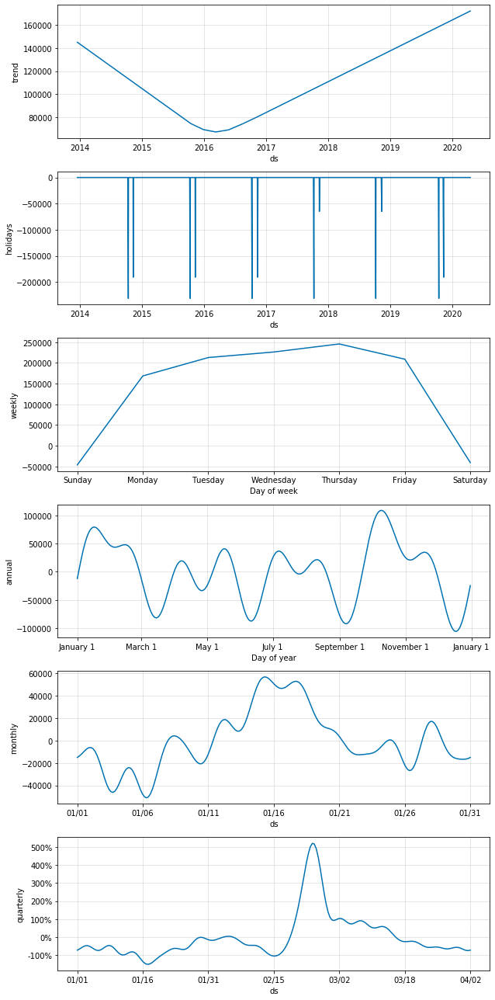

In [937]:
final_model.plot_components(final_model.predict());

<div class="alert alert-block alert-warning">
<h2><b>Interpretation and comparison of these plots</b></h2>
<span style="color:black"> 


- there are many more waves in each seasonality, perhaps indicating some overfitting in each period or else picking up more subtle differences (if they truly exist)
- the overall shapes are very similar to the manual created seasonalities
- the quarterly seasonality still has the overriding impact at \~1.5-2 months into each quarter. **This still far outweighs any other effect**

In [938]:
cv_Prophet_final = cross_validation(final_model, initial='1096 days', period='91 days', horizon = '182 days')


INFO:fbprophet:Making 12 forecasts with cutoffs between 2017-01-19 00:00:00 and 2019-10-17 00:00:00


In [939]:
cv_performances_final = performance_metrics(cv_Prophet_final, rolling_window=0.1)

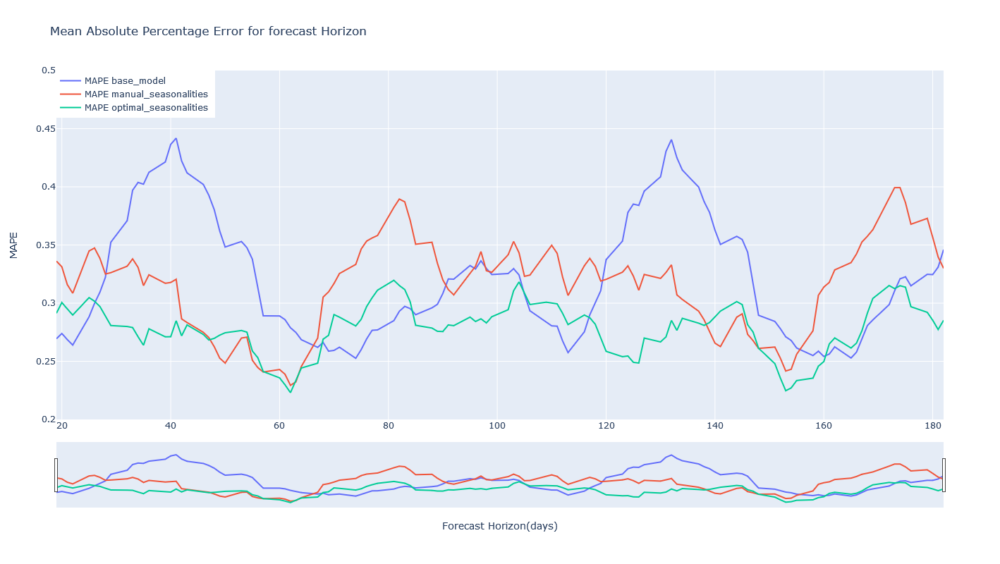

In [940]:
fig = plotly_base_fig(title='Mean Absolute Percentage Error for forecast Horizon', xtitle='Forecast Horizon(days)', ytitle='MAPE')

fig.add_scatter(x=cv_performances['Prophet_cpp0.05'].horizon.dt.days, y=cv_performances['Prophet_cpp0.05'].mape, mode='lines', name='MAPE base_model')
fig.add_scatter(x=cv_performances_seas1.horizon.dt.days, y=cv_performances_seas1.mape, mode='lines', name='MAPE manual_seasonalities')
fig.add_scatter(x=cv_performances_final.horizon.dt.days, y=cv_performances_final.mape, mode='lines', name='MAPE optimal_seasonalities')

#fig.add_scatter(x=cv_performance_log.horizon.dt.days, y=cv_performance_log.mape, mode='lines', name='MAPE-log', line_color='red', opacity=1.0)

fig.update_yaxes(range=[0.2, 0.5])
fig.show()

<div class="alert alert-block alert-warning">
<span style="color:black"> 

The MAPE comparisons show us that this model has more stable and lower overall error results vs. the history

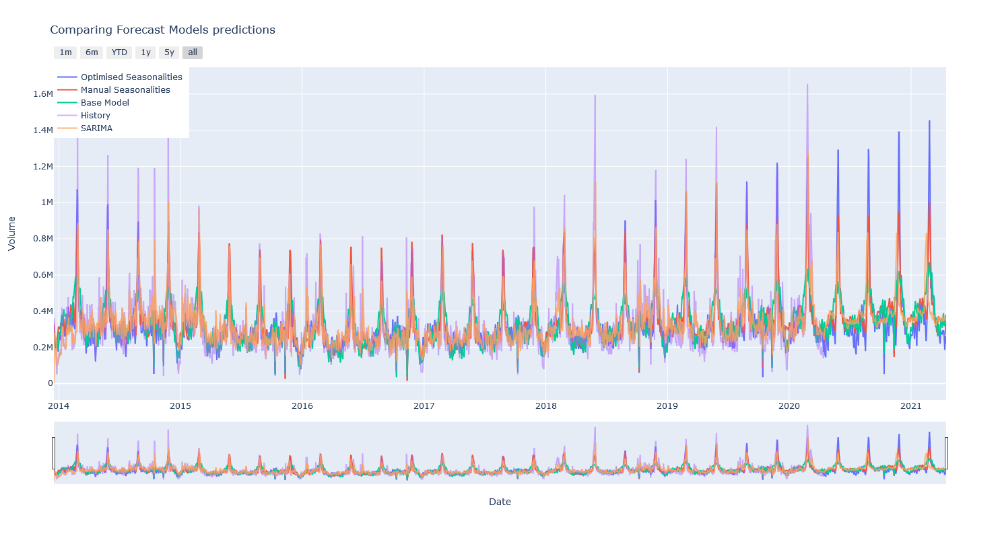

In [977]:
fig = plotly_base_fig(title='Comparing Forecast Models predictions', xtitle='Date', ytitle='Volume')

seaspredict2 = final_model.predict(remove_weekends(final_model.make_future_dataframe(periods=365)))

fig.add_scatter(x=seaspredict2.ds, y=seaspredict2.yhat, mode='lines', name='Optimised Seasonalities')
fig.add_scatter(x=seaspredict1.ds, y=seaspredict1.yhat, mode='lines', name='Manual Seasonalities')
fig.add_scatter(x=linpredict.ds, y=linpredict.yhat, mode='lines', name='Base Model')
fig.add_scatter(x=fbdf.ds, y=fbdf.y, mode='lines', name='History', opacity=0.5)
fig.add_scatter(x=xvals, y=ypred, mode='lines', name='SARIMA', opacity=0.8)

fig.show()

In [759]:
# Generate all 3 statistical tests for each model where the true values are > Mean + 2 * Standard Deviation

# outliers = ARIMApredictions.loc[ARIMApredictions.Actual > modelmean + 2*modelstd, :]

# cols = ['AR(1)', 'SAR(61)', 'SAR(63)']

# RMSE2 = [mean_squared_error(outliers.Actual, outliers[col], squared=False) for col in cols]
# MAPE2 = [mean_absolute_percentage_error(outliers.Actual, outliers[col]) for col in cols]
# SMAPE2 = [smape(outliers.Actual, outliers[col]) for col in cols]

# testresults = pd.DataFrame((RMSE2, MAPE2, SMAPE2), index=['RMSE','MAPE','SMAPE'], columns=['AR(1)', 'SAR(61)', 'SAR(63)']).T

In [990]:
# add the Prophet predictions to the outliers dataframe
newoutliers = outliers
newoutliers['Prophet']=seaspredict2.set_index('ds').yhat

cols = ['AR(1)', 'SAR(61)', 'SAR(63)', 'Prophet']

RMSE2 = [mean_squared_error(outliers.Actual, outliers[col], squared=False) for col in cols]
MAPE2 = [mean_absolute_percentage_error(outliers.Actual, outliers[col]) for col in cols]
SMAPE2 = [smape(outliers.Actual, outliers[col]) for col in cols]

testresults = pd.DataFrame((RMSE2, MAPE2, SMAPE2), index=['RMSE','MAPE','SMAPE'], columns=cols).T


In [992]:
testresults.style.highlight_min(axis=0)

,RMSE,MAPE,SMAPE
AR(1),403341.2777,34.8440,45.0380
SAR(61),403868.0289,34.9400,45.2580
SAR(63),366608.8045,30.2790,38.5636
Prophet,283633.5019,25.0482,30.0693


<div class="alert alert-block alert-success">
<h1><b>Comparison of results, SARIMA vs. fbProphet</b></h1>
<span style="color:black"> 
    
The SARIMA model was easier to build and more interpretable than the fbProphet model. The number of hyperparameters of the fpProphet model, and their lack of practical/real-world explainability means we are operating in far more of a "black-box" environment with this model than with the SARIMA model.  
    
Both models highlight the overriding importance of quarterly seasonality. The fbProphet model allows more readily for more seasonalities (and could be extended to the longer-term, 7-10 year trend) whereas the SARIMA model really only includes a single one. Whether such-long term seasonalities really exist to the extent that they have some value to add to the short-term predictive model could readily be argued against.  Thus, for the purposes of this project the quarterly seasonality is determined to be a far more important facto than all others which both modelling approaches have brought out.
    
As we are concerned not about perfect predictability but the ability to forecast extreme events (i.e. when the daily volume increases beyond 2 or 3 standard deviations from the mean) the Prophet model provides the best indicator for this as the error is 22.5% less (when comparing the RMSE results) than the best SARIMA model. However, I feel that the SARIMA model is more adaptable to new information than the fbProphet model as the fbProphet model will rely on the regularity of fit of the various underlying Fourier functions that make it up and may not take the impact of each new datapoint so well. The SARIMA model also proves that the most recent information as well as the quarterly seasonality is most relevant to the next prediction. Thus, any day in the future that have a trading volume further from the mean may be considered to continue on that extreme path by the SARIMA model. In reality, this is a likely scenario.
    
In either case, accuracy of prediction vs. history is not particularly high (MAPE scores \~28% for each) but this difference is fine given that the absolute variation in volume this implies (\~130,000 contracts) is one that has little additional impact to the infrastructure supporting the market. The error vs. extreme events is even higher but those are so much further, and the model match them pretty well that we can use these as the basis for some future judgements.
    </span>
</div>

<div class="alert alert-block alert-danger">
<h1><b>How could these models be improved?</b></h1>
<span style="color:black"> 
    
Some possibilities to extend the model would include:
    
- applying more techniques for better future outlier detection
- ensemble modelling with more, correlated datapoints
    - these could be other financial market prices/volumes etc or alternative data sources such as sentiment analysis
- examining more closely the noise element of each model which is still high. Either we don't have enough information to better model it or it should be accepted/proven that this will always be the case.
    
Examining the causes of daily volatility of these markets is a whole different subject matter and far beyond the scope of this project

<div class="alert alert-block alert-info">
<h1><b>Appendix: One possible model expansion</b></h1>
<h2><b>Exogenous variables & Time-Lagged Cross Correlation</b></h2>    
<span style="color:black"> 

The volume of trading activity may not in reality not be linked to the absolute price of another asset: asset prices tend to rise, even if only due to inflation and if that is expected/predictable or there is general consensus then there will be far less likelihood of an extreme event ocurring within that market.  It is the volatility of expectations, other markets and less well explainable actions (e.g. the Trump twitter feed!) that will add an exogenous shock and impact trading activity as expectations change. 

We have also seen that there is a trend in the volume of futures trading that as well as short- and long-term seasonality/cyclicality in trading activity but the day-to-day volume is highly volatile. It would be very hard to justify a link between daily trading volumes of different assets unless we were able to include other exogenous shocks having a significant impact, e.g.: 
- political announcements
- unexpected changes to the status quo (e.g. Coronavirus pandemic)
- large shocks to the financial system (e.g. those previously mentioned in 1997/8, 2001, 2008)  

These are not tracked through any tradeable assets, rather those assets are influenced by such shocks.  

So, if we don't have the scope to work on predicting large, exogenous shocks, what can we do identify when there may be some other changes to the environment that is reflected in market assets and may have an impact on trading volumes?  
<b> Rather than consider asset prices or their daily trading volume as potential leading indicators, we can look at the % change or volatility trend of those asset prices</b>  

$H_0: \text{The daily trading volume of US Treasury futures can be better modelled by including the volality of other highly liquid futures contracts}$  <br>
$H_A: \text{The daily trading volume of US Treasury futures is not better modelled by including the volality of other highly liquid futures contracts}$  

<div class="alert alert-block alert-info">

<h2><b>Load more data</b></h2>    
<span style="color:black"> 

I'm going to look at the 1-month, annualised realised volatility of:
 - the S&P500 stock market index, 
 - the West Texas Intermediary Crude Oil front-month futures contract, and
 - the spot Gold price in US Dollars 
    
These are representative of the stock, oil and gold markets, three completely different assets that at times of stress may be indicators for US Treasury trading volume as people rush to buy or sell them.

In [524]:
import yfinance as yf


In [605]:
# S&P500
spx = yf.Ticker('^GSPC')


In [608]:
spx_hist = spx.history(period='max')

In [565]:
spx_hist.tail(10)

,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,
2020-04-13,2782.46,2782.46,2721.17,2761.63,5274310000,0,0
2020-04-14,2805.10,2851.85,2805.10,2846.06,5567400000,0,0
2020-04-15,2795.64,2801.88,2761.54,2783.36,5203390000,0,0
2020-04-16,2799.34,2806.51,2764.32,2799.55,5179990000,0,0
2020-04-17,2842.43,2879.22,2830.88,2874.56,5792140000,0,0
2020-04-20,2845.62,2868.98,2820.43,2823.16,5220160000,0,0
2020-04-21,2784.81,2785.54,2727.10,2736.56,5075830000,0,0
2020-04-22,2787.89,2815.10,2775.95,2799.31,5049660000,0,0
2020-04-23,2810.42,2844.90,2794.26,2797.80,5756520000,0,0


In [603]:
xau_hist

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,


In [590]:
# Crude Oil (another rolling front-month futures contract) 
wti = quandl.get("CHRIS/CME_CL1", authtoken=mytoken)

In [575]:
wti.tail(10)

,Open,High,Low,Last,Change,Settle,Volume,Previous Day Open Interest
Date,,,,,,,,
2020-04-13,24.60,24.74,22.03,22.42,0.35,22.41,736591.0,374727.0
2020-04-14,22.36,23.08,19.95,20.82,2.30,20.11,769916.0,324547.0
2020-04-15,20.72,20.89,19.20,20.15,0.24,19.87,529484.0,231678.0
2020-04-16,20.15,20.53,19.42,19.74,NaN,19.87,339086.0,203897.0
2020-04-17,20.00,20.22,17.31,18.12,1.60,18.27,233170.0,148838.0
2020-04-20,17.73,17.85,-40.32,-13.10,55.90,-37.63,231128.0,108593.0
2020-04-21,-14.00,13.86,-16.74,9.06,47.64,10.01,12250.0,13044.0
2020-04-22,13.12,16.19,10.26,14.23,2.21,13.78,1222361.0,460054.0
2020-04-23,14.20,18.26,13.35,16.87,2.72,16.50,817386.0,379358.0


In [609]:
gold = quandl.get('LBMA/GOLD')

In [610]:
gold

,USD (AM),USD (PM),GBP (AM),GBP (PM),EURO (AM),EURO (PM)
Date,,,,,,
1968-01-02,35.18,NaN,14.641,NaN,NaN,NaN
1968-01-03,35.16,NaN,14.617,NaN,NaN,NaN
1968-01-04,35.14,NaN,14.603,NaN,NaN,NaN
1968-01-05,35.14,NaN,14.597,NaN,NaN,NaN
1968-01-08,35.14,NaN,14.586,NaN,NaN,NaN
...,...,...,...,...,...,...
2020-04-20,1684.95,1686.20,1349.140,1355.70,1547.63,1551.98
2020-04-21,1678.60,1682.05,1358.160,1364.82,1548.00,1547.82
2020-04-22,1702.65,1710.55,1377.950,1388.28,1567.46,1576.44


<div class="alert alert-block alert-info">

<h2><b>Realised Volatility</b></h2>    
<span style="color:black"> 

Although financial instruments trade continuously, I will be considering the realised DAILY volatility of these instruments from one Close price to the next and annualising that in accordance with the following formula:  

$\Large{\sqrt{\frac{252}{n}\sum_{t=1}^{n} R_t^2}}$  

where,  

$\Large{R_t = \ln\frac{P_t}{P_{t-1}}}$  

252 = number of business days in a year
    
*should any value be negative then the percentage daily change will be used rather than the natural log of the ratio of daily prices*

In [625]:
log_rtn, real_var, real_vol = realised_vol(spx_hist.Close)

In [626]:
spx_hist['spx_rv'] = real_vol

In [627]:
spx_hist.tail(21)

,Open,High,Low,Close,Volume,Dividends,Stock Splits,spx_rv
Date,,,,,,,,
2020-03-26,2501.29,2637.01,2500.72,2630.07,7753160000,0,0,0.944409
2020-03-27,2555.87,2615.91,2520.02,2541.47,6194330000,0,0,0.938891
2020-03-30,2558.98,2631.80,2545.28,2626.65,5746220000,0,0,0.945377
2020-03-31,2614.69,2641.39,2571.15,2584.59,6568290000,0,0,0.934105
2020-04-01,2498.08,2522.75,2447.49,2470.50,5947900000,0,0,0.941943
2020-04-02,2458.54,2533.22,2455.79,2526.90,6454990000,0,0,0.934273
2020-04-03,2514.92,2538.18,2459.96,2488.65,6087190000,0,0,0.928098
2020-04-06,2578.28,2676.85,2574.57,2663.68,6391860000,0,0,0.955642
2020-04-07,2738.65,2756.89,2657.67,2659.41,7040720000,0,0,0.915626


In [628]:
_, _, wti_rv = realised_vol(wti.Settle, log_returns=False)

In [629]:
wti['wti_rv'] = wti_rv

In [630]:
wti.tail(21)

,Open,High,Low,Last,Change,Settle,Volume,Previous Day Open Interest,wti_rv
Date,,,,,,,,,
2020-03-26,24.25,24.65,22.38,23.18,1.89,22.60,626433.0,550318.0,0.364904
2020-03-27,23.29,23.44,20.88,21.84,1.09,21.51,591705.0,564179.0,0.365149
2020-03-30,20.93,20.93,19.27,20.28,1.42,20.09,739372.0,579954.0,0.365862
2020-03-31,20.23,21.89,20.01,20.10,0.39,20.48,642994.0,610071.0,0.363206
2020-04-01,20.10,21.55,19.90,21.20,0.17,20.31,693167.0,627441.0,0.362224
2020-04-02,21.22,27.39,20.76,24.75,5.01,25.32,1088575.0,628603.0,0.419754
2020-04-03,24.81,29.13,23.52,29.00,3.02,28.34,983892.0,634727.0,0.433101
2020-04-06,26.09,28.24,25.28,26.30,2.26,26.08,748508.0,595835.0,0.430908
2020-04-07,26.34,27.24,23.54,24.26,2.45,23.63,762093.0,579261.0,0.395763


<div class="alert alert-block alert-danger">
<span style="color:black"> 

It is worth pointing out that recently there was a unique event in the price of West Texas Intermediary as it went negative for the first time ever, meaning that people were being paid to take delivery of oil from producers. This was due to an anomaly in the real world where, because of the massive drop in demand for oil as a result of the global lockdown measures put in place to control the spread of coronavirus, in conjunction with a much smaller cut in production, the storage facilities for oil are nearly full and no-one wanted to pay to take delivery of oil when the futures contract expired.  

In [634]:
# Use the USD price fixing in the London morning (there are breaks in the PM fixing)

_, _, gold_rv = realised_vol(gold['USD (AM)'])

In [635]:
gold['gold_rv'] = gold_rv

In [636]:
gold.tail(21)

,USD (AM),USD (PM),GBP (AM),GBP (PM),EURO (AM),EURO (PM),gold_rv
Date,,,,,,,
2020-03-25,1620.95,1605.45,1357.22,1371.38,1494.84,1486.17,0.384024
2020-03-26,1620.10,1634.80,1361.37,1358.19,1480.12,1487.01,0.383666
2020-03-27,1621.20,1617.30,1325.33,1316.16,1473.18,1469.48,0.383663
2020-03-30,1624.45,1618.30,1312.56,1305.97,1466.88,1466.02,0.381324
2020-03-31,1604.65,1608.95,1299.61,1296.81,1461.52,1468.81,0.382023
2020-04-01,1594.25,1576.55,1288.95,1270.23,1457.94,1442.86,0.381995
2020-04-02,1588.05,1616.80,1277.59,1307.02,1452.27,1489.72,0.369531
2020-04-03,1609.75,1613.10,1310.66,1315.97,1490.47,1495.34,0.372468
2020-04-06,1636.60,1648.30,1330.72,1341.06,1515.49,1526.66,0.367781


In [637]:
# fig = plotly_base_fig('Gold Price Chart', 'Date', 'Price')
# fig.add_scatter(x=gold.index, y=gold['USD (AM)'], mode='lines', name='Gold AM vol')
# fig.add_scatter(x=gold.index, y=gold['USD (PM)'], mode='lines', name='Gold PM vol')
# fig.show()


<div class="alert alert-block alert-info">

<h2><b>Visualise the whole volatility time series</b></h2>    
<span style="color:black"> 


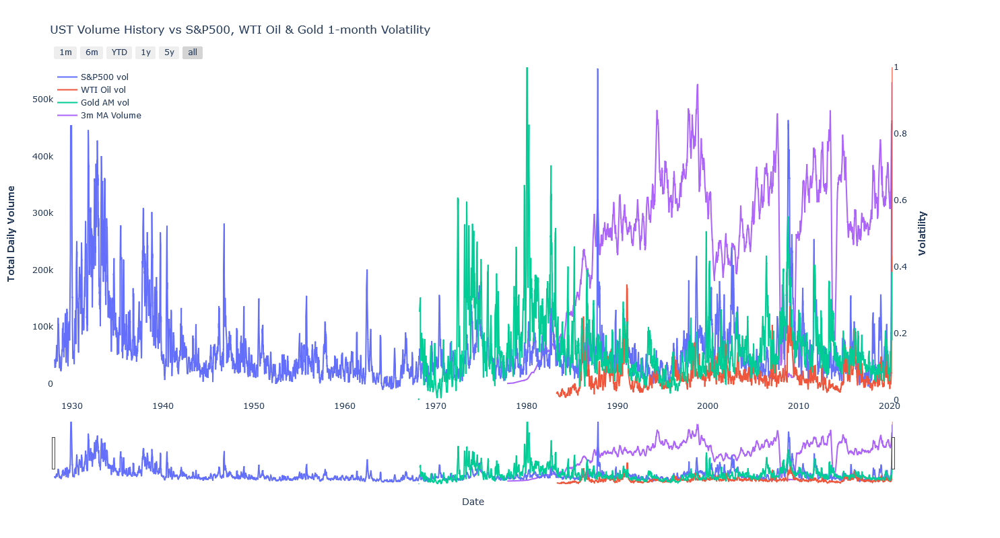

In [697]:
# time index
idx = data_UST.index

# base figure
fig = plotly_base_fig('UST Volume History vs S&P500, WTI Oil & Gold 1-month Volatility', 'Date', 'Volume', specs=[[{"secondary_y": True}]])
fig.update_layout(plot_bgcolor='white')

# add time series lines
# fig.add_scatter(x=idx, y=data_UST['Total Volume'], mode='lines', name='Total Volume', opacity=0.5) # remove as makes the plot unclear
fig.add_scatter(x=spx_hist.index, y=spx_hist.spx_rv, mode='lines', secondary_y=True, name='S&P500 vol')
fig.add_scatter(x=wti.index, y=wti.wti_rv, mode='lines', secondary_y=True, name='WTI Oil vol')
fig.add_scatter(x=gold.index, y=gold.gold_rv, mode='lines', secondary_y=True, name='Gold AM vol')
fig.add_scatter(x=idx, y=data_UST['3m Moving Average'], mode='lines', name='3m MA Volume')

# Set y-axes titles
fig.update_yaxes(title_text="<b>Total Daily Volume</b>", secondary_y=False)
fig.update_yaxes(title_text="<b>Volatility</b>", range=[0, 1], secondary_y=True)

fig.show()

<div class="alert alert-block alert-info">

<h2><b>Time-Lagged Cross Correlation</b></h2>    
<span style="color:black"> 

Inspecting the chart apart just visually there does appear to be some syncronicity between the volatility of the S&P500, WTI Crude Oil and Gold price.  

Whilst we could look at this more statistically by the Pearson's correlation function, that only considers the correlation of one dataset to another. It is possible that the correlation between the US Treasury futures volumes and each of these volatility indices is lagged, or even changes throughout time.

In [652]:
# put all the data into a single dataframe

alldata = pd.DataFrame(model1data)#.merge(spx_hist.spx_rv, left_on=alldata)
alldata = alldata.merge(spx_hist.spx_rv, left_on='Date', right_on=spx_hist.index)
alldata = alldata.merge(wti.wti_rv, left_on='Date', right_on=wti.index)
alldata = alldata.merge(gold.gold_rv, left_on='Date', right_on=gold.index)

alldata

,Date,Total Volume,spx_rv,wti_rv,gold_rv
0,2014-01-02,174677.0,0.098736,0.038813,0.165912
1,2014-01-03,152138.0,0.098119,0.036223,0.168245
2,2014-01-06,187407.0,0.098401,0.034837,0.160761
3,2014-01-07,160330.0,0.099484,0.034887,0.159856
4,2014-01-08,325609.0,0.091646,0.035918,0.151575
...,...,...,...,...,...
1553,2020-04-08,185216.0,0.907708,0.389948,0.366519
1554,2020-04-09,178382.0,0.892352,0.394488,0.367443
1555,2020-04-14,188391.0,0.770650,0.399439,0.379525
1556,2020-04-15,228377.0,0.635859,0.394334,0.365012


In [654]:
def crosscorr(datax, datay, lag=0, wrap=False):
    """ 
    Computes time-lagged cross correlation where 'datay' is shifted by 'lag'
    Shifted data filled with NaNs 
    
    Parameters
    ----------
    lag : int, default 0
    datax, datay : pandas.Series objects of equal length
    
    Returns
    ----------
    crosscorr : float
    """
    if wrap:
        shiftedy = datay.shift(lag)
        shiftedy.iloc[:lag] = datay.iloc[-lag:].values
        return datax.corr(shiftedy)
    else: 
        return datax.corr(datay.shift(lag))

In [681]:
d1 = alldata['Total Volume']
d2 = alldata.spx_rv
d3 = alldata.wti_rv
d4 = alldata.gold_rv

lwr = -50
upp = 50

tlcc_spx = [crosscorr(d1,d2, lag) for lag in range(lwr, upp + 1)]
tlcc_wti = [crosscorr(d1,d3, lag) for lag in range(lwr, upp + 1)]
tlcc_gold = [crosscorr(d1,d4, lag) for lag in range(lwr, upp + 1)]

offset_spx = lwr + np.argmax(tlcc_spx)
offset_wti = lwr + np.argmax(tlcc_wti)
offset_gold = lwr + np.argmax(tlcc_gold)

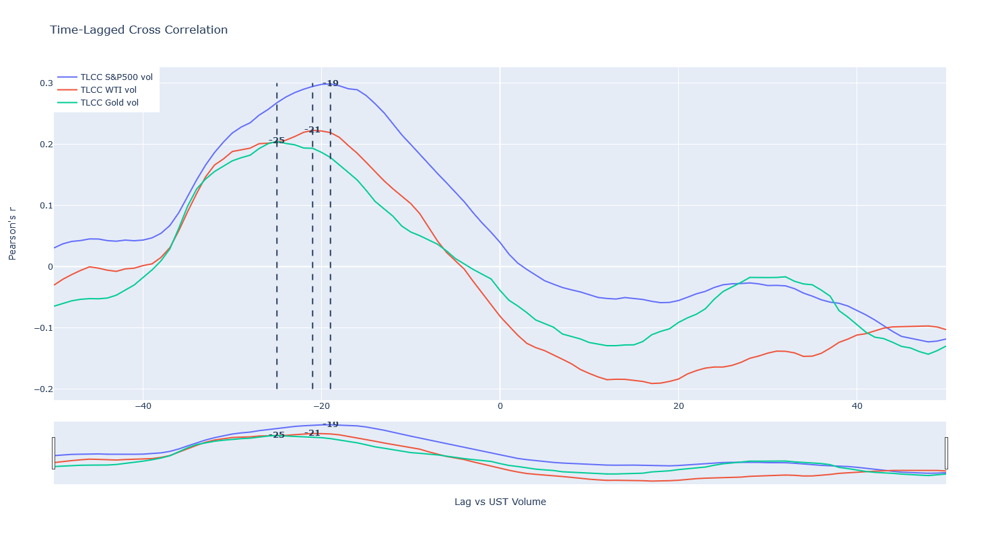

In [688]:
fig = plotly_base_fig('Time-Lagged Cross Correlation', 'Lag vs UST Volume', "Pearson's r")

xrange = np.arange(lwr, upp+1)

fig.add_scatter(x=xrange, y=tlcc_spx, mode='lines', name='TLCC S&P500 vol')
fig.add_scatter(x=xrange, y=tlcc_wti, mode='lines', name='TLCC WTI vol')
fig.add_scatter(x=xrange, y=tlcc_gold, mode='lines', name='TLCC Gold vol')

# Add vertical lines
for ln in [offset_spx, offset_wti, offset_gold]:
    fig.add_shape(dict(type='line', 
                       x0=ln, 
                       y0=-0.2, 
                       x1=ln, 
                       y1=0.3, 
                       line=dict(width=2, dash='dash')
                      )
                 )
# Add labels
fig.add_trace(go.Scatter(
    x=[offset_spx, offset_wti, offset_gold],
    y=[np.max(tlcc_spx), np.max(tlcc_wti), np.max(tlcc_gold)],
    text=[f'<b>{offset_spx}</b>', f'<b>{offset_wti}</b>', f'<b>{offset_gold}</b>'],
    mode='text', showlegend=False
    ))

fig.show();

<div class="alert alert-block alert-success">
<h1><b>Summary</b></h1>
<span style="color:black"> 

The Time-Lagged Cross Correlation graph shows us that there is a small time-lagged correlation of the US Treasury futures volume with each of the volatility of the S&P500, WTI Crude Oil and Gold prices.  It peaks between 19 and 25 days prior but the correlation is not significant at only 20-30%.
    </span>
    </div>
 <div class="alert alert-block alert-success">   
  
<h1><b>Next Steps</b></h1>
<span style="color:black"> 
To further expand this path would entail exploring Grainger Causality and Vector Auto Regressive Models or perhaps building a more complex (linear) regression model where one of the features is the predictions from the time series model and other features are these.  
    
**A problem for another time**


Proving that,  
$\Large{y = \sum_{n=1}^{\infty}{n} = 1 + 2 + 3 + 4 + ... = -\frac{1}{12}}$  

$\Large{\sum_{n=0}^{\infty}{x^n} = 1 + x + x^2 + x^3 + ... = \frac{1}{1-x}, where x<1}$  
$\Large{\frac{dy}{dx} = \sum_{n=0}^{\infty}{nx^{n-1}} = 1 + 2x + 3x^2 + 4x^3 + ... = \frac{1}{(1-x)^2}}$  
  
Let x=-1:  
$\Large{1 -2 + 3 - 4 + ... = \frac{1}{4}}$  

Define, Reimann function:  
$\Large{\zeta(s) = \sum_{n=0}^{\infty}\frac{1}{n^s} = 1 + \frac{1}{2^s} + \frac{1}{3^s} + \frac{1}{4^s} +...}$  

therefore:  
$\Large{2^{-s}\zeta(s) = 2^{-s} + 4^{-s} + 6^{-s} + ...}$  

$\Large{(1-2.2^{-s})\zeta(s) = (1 + 2^{-s} + 3^{-s} + 4^{-s} +...) - 2(2^{-s} + 4^{-s} + 6^{-s} + ...)}$  
$\Large{= 1 - 2^{-s} + 3^{-s} - 4^{-s} + ...}$  

if s = -1:  
$\Large{-3\zeta(-1) = 1 - 2 + 3 - 4 + ... = \frac{1}{4}}$,  

rearranging:
$\Large{\zeta(-1) = -\frac{1}{12}}$

$\Large{Q.E.D.}$


In [703]:
np.busday_offset('2013-12-31','-7')


numpy.datetime64('2013-12-20')

# 